<a href="https://colab.research.google.com/github/afvallejo/Platelets/blob/main/3_Annotattion_cellranger_24112021.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

## link Gdrive

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [ ]:
!mkdir MyDrive   
!mount --bind /content/drive/My\ Drive /content/MyDrive

#Colab

In [ ]:
%cd /content/

/content


In [ ]:
pip install cffi==1.14.6

     |████████████████████████████████| 402 kB 16.2 MB/s 
  Attempting uninstall: cffi
    Found existing installation: cffi 1.15.0
    Uninstalling cffi-1.15.0:
      Successfully uninstalled cffi-1.15.0


In [ ]:
!pip install pynndescent
!pip install -q condacolab
import condacolab
condacolab.install()

!conda install -y graphviz
!pip install cffi==1.14.6
!pip install pygraphviz
!pip install leidenalg
!pip install umap-learn==0.5.1
!pip install scanpy
!pip install cello-classify
import umap
umap.__version__ = '0.5.1'


In [ ]:
!cp /content/MyDrive/tools/scanpy.zip /content/

In [ ]:
%%capture
!unzip /content/scanpy.zip

In [ ]:
pip install setuptools-scm install scanpy anndata leidenalg scrublet bbknn

     |████████████████████████████████| 646 kB 15.3 MB/s 
     |████████████████████████████████| 29.2 MB 1.3 MB/s 
     |████████████████████████████████| 3.3 MB 62.2 MB/s 
     |████████████████████████████████| 6.1 MB 58.7 MB/s 
     |████████████████████████████████| 178 kB 76.5 MB/s 
  Created wheel for annoy: filename=annoy-1.17.0-cp37-cp37m-linux_x86_64.whl size=391842 sha256=d204fcce69f7bfa0921b59dbc79a76fbdf022dc2cd5f421101cc1b5e3ed85f86
  Stored in directory: /root/.cache/pip/wheels/4f/e8/1e/7cc9ebbfa87a3b9f8ba79408d4d31831d67eea918b679a4c07
Successfully built annoy


In [ ]:
import os
os.environ["FLIT_ROOT_INSTALL"] = "1"

In [ ]:
!python3 -m pip install flit

     |████████████████████████████████| 49 kB 4.5 MB/s 
     |████████████████████████████████| 570 kB 32.4 MB/s 
     |████████████████████████████████| 45 kB 3.2 MB/s 


In [ ]:
%cd /content/scanpy-02b091a02a6bc962ee83ebeea85bffe8746f1859

/content/scanpy-02b091a02a6bc962ee83ebeea85bffe8746f1859


In [ ]:
!flit install -s --deps=develop

>Fetching list of valid trove classifiers                         I-flit.validate
Extras to install for deps 'develop': {'test', 'dev', '.none', 'doc'}  I-flit.install
Installing requirements                                           I-flit.install
     |████████████████████████████████| 280 kB 15.3 MB/s 
     |████████████████████████████████| 1.0 MB 61.6 MB/s 
     |████████████████████████████████| 132 kB 62.9 MB/s 
     |████████████████████████████████| 146 kB 63.4 MB/s 
     |████████████████████████████████| 193 kB 57.9 MB/s 
     |████████████████████████████████| 155 kB 69.2 MB/s 
     |████████████████████████████████| 3.1 MB 65.5 MB/s 
     |████████████████████████████████| 2.8 MB 38.5 MB/s 
     |████████████████████████████████| 843 kB 51.3 MB/s 
     |████████████████████████████████| 749 kB 74.3 MB/s 
     |████████████████████████████████| 97 kB 8.1 MB/s 
     |████████████████████████████████| 55 kB 3.8 MB/s 
     |████████████████████████████████| 596 kB 72.6 MB/s 


## Load packages

In [ ]:
import scanpy as sc
import numpy as np
import re
import pandas as pd
import seaborn as sb
import matplotlib
import matplotlib.pyplot as pl
import scanpy.external as sce
from matplotlib import colors
import bbknn
sc._settings.ScanpyConfig.n_jobs=8

pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
sc.set_figure_params(color_map='viridis')
colorsComb = np.vstack([pl.cm.Reds(np.linspace(0, 1, 10)), pl.cm.Greys_r(np.linspace(0.7, 0.8, 0))])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

#cello_resource_loc = os.getcwd()
cello_resource_loc = "."


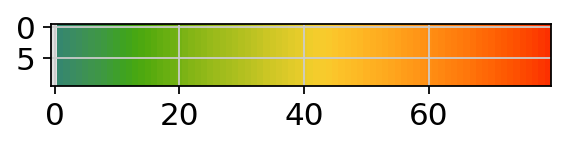

In [ ]:
import colorcet as cc

xs, _ = np.meshgrid(np.linspace(0, 1, 80), np.linspace(0, 1, 10))
colorsComb = np.vstack([pl.cm.Greys_r(np.linspace(0.8,0.1, 1)), cc.cm.rainbow_bgyr_35_85_c72(np.linspace(0.2,1, 100))])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)
pl.imshow(xs, cmap=mymap);  # use tab completion to choose

# Setup

## set WD

In [ ]:
folder='/content/MyDrive/Constellation/Aligned/'

samplename='CTR'
random_state=42

import os
os.chdir(folder)
if not os.path.exists('./figures'):
    os.makedirs('./figures')

# Load the data

In [ ]:
adata=sc.read('/content/MyDrive/Constellation/Aligned/constellation/outs/filtered_feature_bc_matrix/GEX1_clean_taged.h5ad')
adata


AnnData object with n_obs × n_vars = 8316 × 36601
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet'

In [ ]:
print(adata.obs['sample'].value_counts())

LPS    4260
CTR    4056
Name: sample, dtype: int64


In [ ]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_counts = 500)
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = 50000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

adata = adata[adata.obs['mt_frac'] < 0.3]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_genes = 250)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 8316
Number of cells after min count filter: 8316
Number of cells after max count filter: 8316
Number of cells after MT filter: 8159


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 8152


In [ ]:
sc.pp.filter_genes(adata, min_cells=3)


In [ ]:
adata.layers["counts"]=adata.X

In [ ]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)



# compute qc metrics
regex = re.compile('^(MT-).*', re.IGNORECASE)
mito_genes = [l for l in adata.var_names for m in [regex.search(l)] if m]
adata.var['mito'] = False
adata.var.loc[mito_genes, 'mito'] = True
adata.obs['mt_frac'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
print('Found {} mito genes and annotated.'.format(len(mito_genes)))

sc.pp.calculate_qc_metrics(adata, qc_vars=['mito'], inplace=True)


adata

Found 13 mito genes and annotated.


AnnData object with n_obs × n_vars = 8152 × 22842
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'scrublet'
    layers: 'counts'

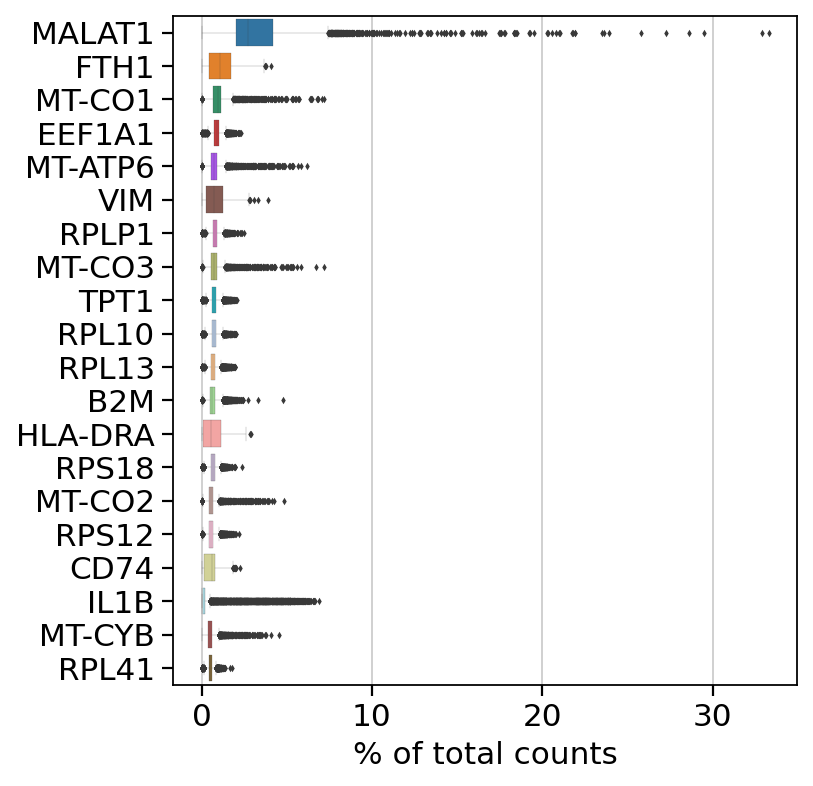

In [ ]:
sb.set_context('paper')
pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
sc.pl.highest_expr_genes(adata, n_top=20,save='top20_shortreads.pdf' )

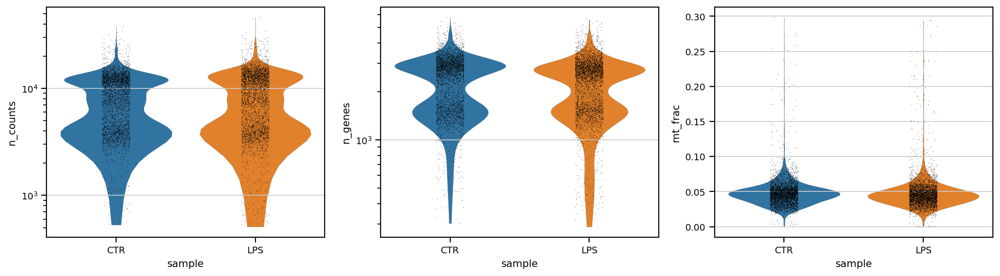

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.violin(adata, 'n_counts', groupby='sample', size=0.5, log=True, cut=0, ax=ax1, show=False)
ax2_dict =  sc.pl.violin(adata, 'n_genes', groupby='sample', size=0.5, log=True, cut=0, ax=ax2, show=False)
ax3_dict = sc.pl.violin(adata, 'mt_frac', groupby='sample',size=0.5, ax=ax3, show=False,)
savefig='figures/'+samplename + '_1_QC_violin_plots.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

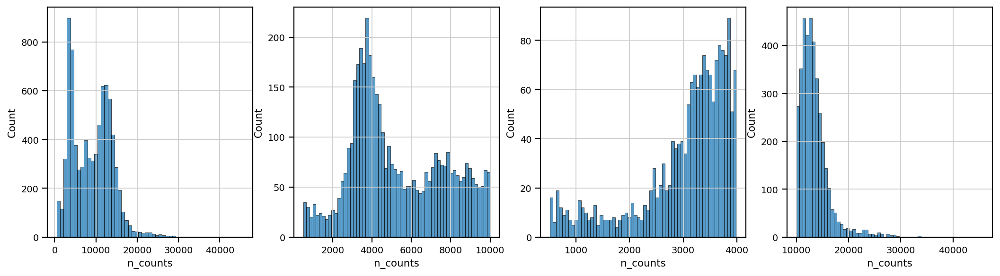

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3,ax4) = plt.subplots(1, 4, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sb.histplot(adata.obs['n_counts'], kde=False, ax=ax1,)
ax2_dict =  sb.histplot(adata.obs['n_counts'][adata.obs['n_counts']<10000], kde=False, bins=60, ax=ax2,)
ax3_dict =  sb.histplot(adata.obs['n_counts'][adata.obs['n_counts']<4000], kde=False, bins=60, ax=ax3,)
ax4_dict = sb.histplot(adata.obs['n_counts'][adata.obs['n_counts']>10000], kde=False, bins=60, ax=ax4, )
savefig='figures/'+samplename + '_2_QC_counts_filtering.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

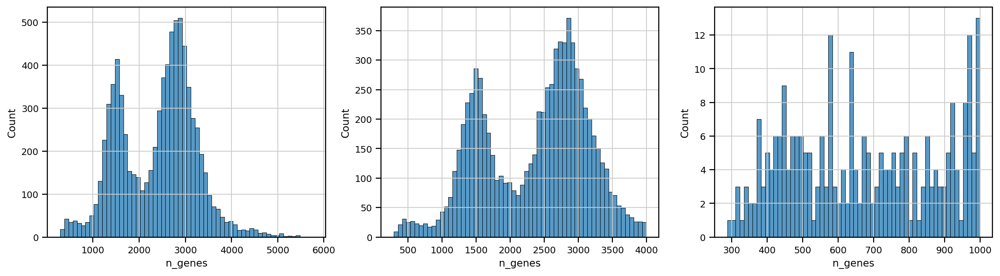

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sb.histplot(adata.obs['n_genes'], kde=False, bins=60, ax=ax1,)
ax2_dict =  sb.histplot(adata.obs['n_genes'][adata.obs['n_genes']<4000], kde=False, bins=60, ax=ax2,)
ax3_dict =  sb.histplot(adata.obs['n_genes'][adata.obs['n_genes']<1000], kde=False, bins=60, ax=ax3,)
savefig='figures/'+samplename + '_3_QC_gene_filtering.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))

#sc.pp.filter_cells(adata, min_counts = 2000)
#print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = 50000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

adata = adata[adata.obs['mt_frac'] < 0.3]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_genes = 250)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 8152
Number of cells after max count filter: 8152
Number of cells after MT filter: 8152


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 8152


In [ ]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 5 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=5)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 22842
Number of genes after cell filter: 21172


In [ ]:
adata.layers["raw"] = adata.X.copy()
adata.layers["sqrt_norm"] = np.sqrt(
    sc.pp.normalize_total(adata, inplace=False)["X"])

# Normalization

In [ ]:
sc.experimental.pp.recipe_pearson_residuals(adata,n_top_genes=2000,n_comps=100,random_state=42,inplace=True,)
#sc.experimental.pp.recipe_pearson_residuals(adata,n_top_genes=2000,n_comps=100,random_state=42,inplace=True,batch_key= 'sample')
adata

AnnData object with n_obs × n_vars = 8152 × 21172
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'scrublet', 'sample_colors', 'hvg', 'pca', 'pearson_residuals_normalization'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'raw', 'sqrt_norm'

In [ ]:
adata.layers["normalized"]=adata.X

## Removal of Mitochondrial and Ribosomal Protein Genes

In [ ]:
ribo_genes = adata.var_names.str.startswith(("RPS","RPL"))
mito_genes = adata.var_names.str.startswith('MT-')
malat1 = adata.var_names.str.startswith('MALAT1')
remove = np.add(ribo_genes,mito_genes)
remove = np.add(remove,malat1)
kept_genes = np.invert(remove)

In [ ]:
adata = adata[:,kept_genes]

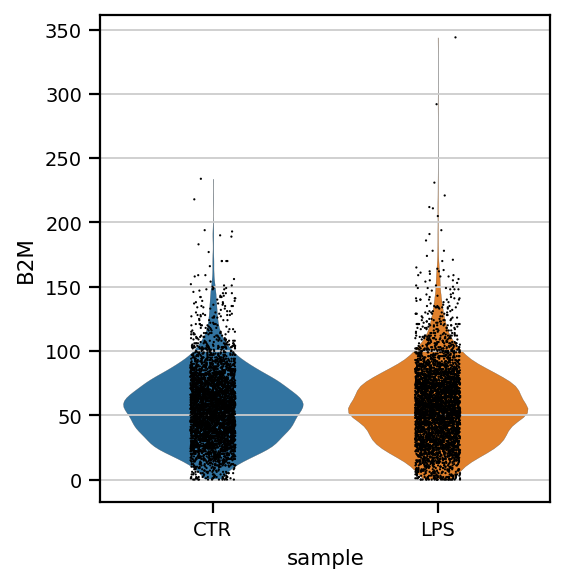

In [ ]:
sc.pl.violin(adata, ['B2M'],groupby='sample')

In [ ]:
adata.layers["normalized"]=adata.X
sc.pp.log1p(adata)
adata.layers["logcounts"] = adata.X

In [ ]:
#sc.pl.violin(adata, ['B2M'],groupby='sample',)

In [ ]:
# Store the full data set in 'raw' as log-normalised data for statistical testing
#adata.raw = adata

In [ ]:
normalized=samplename+"_normalized.h5ad"
print(normalized)
adata.write(normalized)


CTR_normalized.h5ad


In [ ]:
normalized=samplename+"_normalized.h5ad"
adata=sc.read(normalized)
adata

AnnData object with n_obs × n_vars = 8152 × 21057
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization', 'sample_colors', 'scrublet'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'logcounts', 'normalized', 'raw', 'sqrt_norm'

# PCA

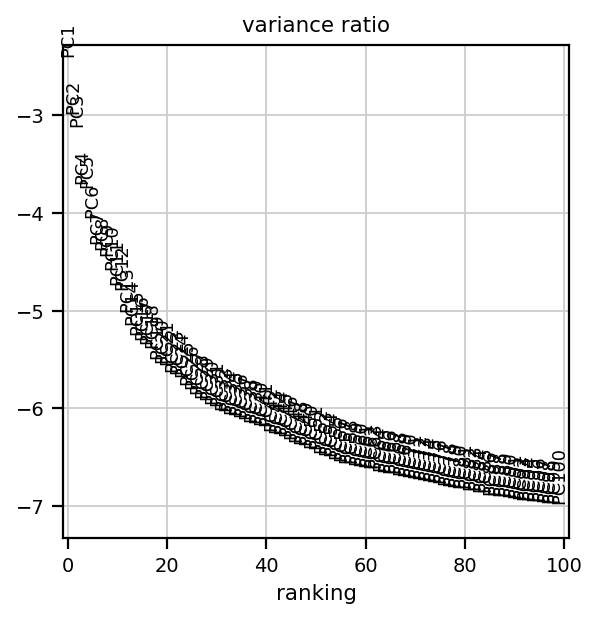

In [ ]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100,log=True)

In [ ]:
####################################
# for using with corrected counts as X only
####################################
#sc.pp.scale(adata,max_value=10)

In [ ]:
#sc.pp.pca(adata, n_comps = 100, use_highly_variable =True, svd_solver = "arpack")
#sc.pl.pca_variance_ratio(adata, n_pcs = 100,log=True)

In [ ]:
#sce.pp.bbknn(adata,batch_key='Group', n_pcs = 100,metric='angular')
#'angular', 'euclidean', 'manhattan', and 'hamming'
#sce.pp.mnn_correct(adata,batch_key='run')

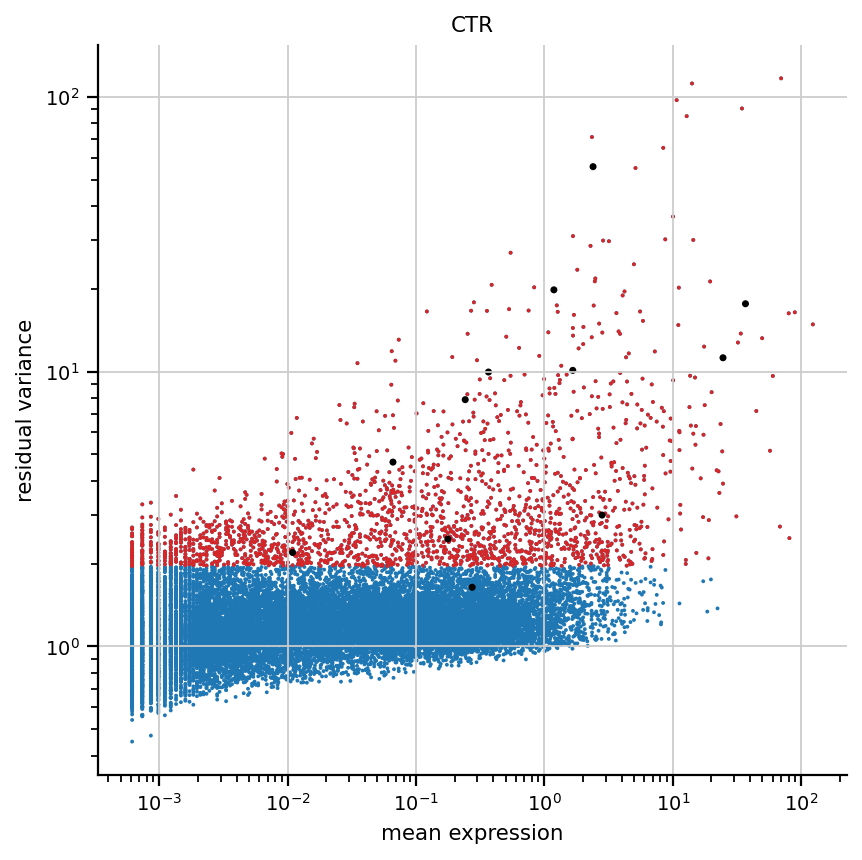

In [ ]:
markers = ["IL7R","LYZ","CD14","MS4A1","CD8A","GNLY","NKG7","FCGR3A","MS4A7","FCER1A","CST3","PPBP",]
hvgs = adata.var["highly_variable"]
fig, ax = plt.subplots(figsize=(6, 6))
pl.scatter(
        adata.var["mean_counts"], adata.var["residual_variances"], s=3, edgecolor="none"
    )
pl.scatter(
        adata.var["mean_counts"][hvgs],
        adata.var["residual_variances"][hvgs],
        c="tab:red",
        label="selected genes",
        s=3,
        edgecolor="none",
    )
pl.scatter(
        adata.var["mean_counts"][np.isin(adata.var_names, markers)],
        adata.var["residual_variances"][np.isin(adata.var_names, markers)],
        c="k",
        label="known marker genes",
        s=10,
        edgecolor="none",
    )
ax.set_xscale("log")
ax.set_xlabel("mean expression")
ax.set_yscale("log")
ax.set_ylabel("residual variance")
ax.set_title(samplename)

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")

In [ ]:
adata

AnnData object with n_obs × n_vars = 8152 × 21057
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization', 'sample_colors', 'scrublet'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'logcounts', 'normalized', 'raw', 'sqrt_norm'

# Neighbors and clustering

In [ ]:
sc.pp.neighbors(adata, n_pcs=50,n_neighbors=10,random_state=random_state)
#bbknn.bbknn(adata,batch_key = "sample", neighbors_within_batch =20, n_pcs = 100)


/usr/local/lib/python3.7/site-packages/scanpy/tools/_tsne.py:115: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  "In previous versions of scanpy, calling tsne with n_jobs > 1 would use "
/usr/local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


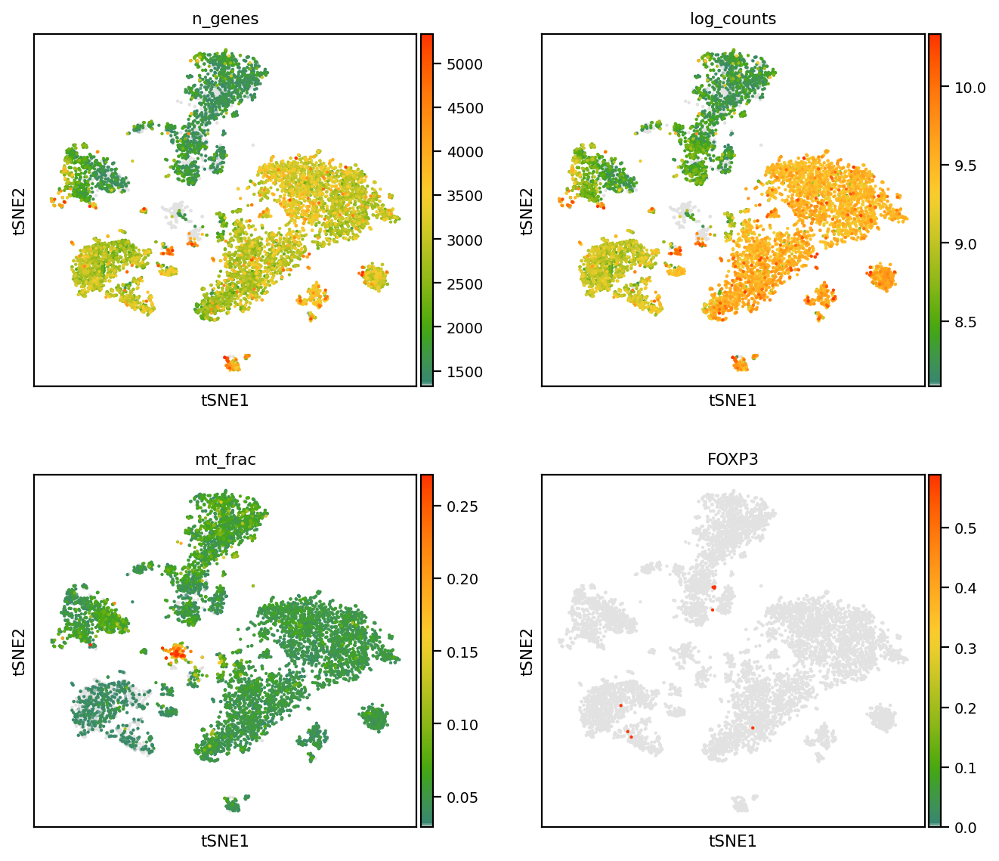

In [ ]:
genes_to_plot = ['n_genes','log_counts','mt_frac','FOXP3']
sc.tl.tsne(adata,random_state=42) 
sc.tl.umap(adata,random_state=42)
savefig="_4_QC_doublets_vst_mito.pdf"
sc.pl.tsne(adata, color = genes_to_plot,ncols=2,cmap=mymap,vmin='p10',vmax='p99.9',save=savefig)

# Clustering

In [ ]:
sc.tl.leiden(adata,random_state=random_state,resolution=1.5, key_added='leiden_r1.5')
sc.tl.leiden(adata,random_state=random_state,resolution=1, key_added='leiden_r1')
sc.tl.leiden(adata,random_state=random_state, resolution=0.8, key_added='leiden_r0.8')
sc.tl.leiden(adata,random_state=random_state, resolution=0.5, key_added='leiden_r0.5')
sc.tl.leiden(adata,random_state=random_state, resolution=0.4, key_added='leiden_r0.4')
sc.tl.leiden(adata,random_state=random_state, resolution=0.3, key_added='leiden_r0.3')
sc.tl.leiden(adata,random_state=random_state, resolution=0.2, key_added='leiden_r0.2')

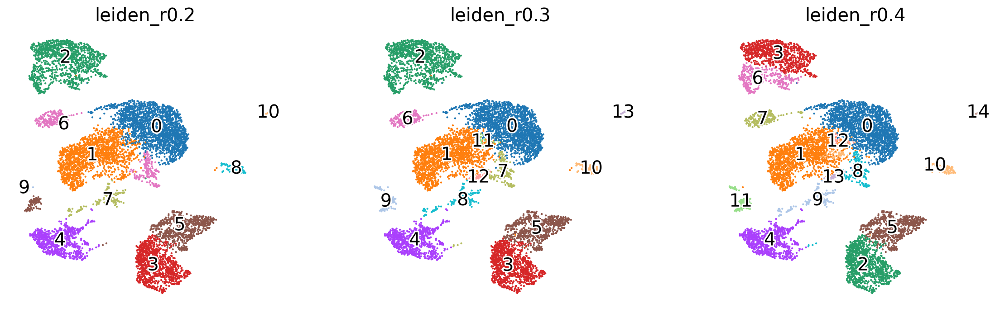

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_5_clustering_vst_lowres.pdf"
sc.pl.umap(adata, color=['leiden_r0.2','leiden_r0.3','leiden_r0.4'], legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

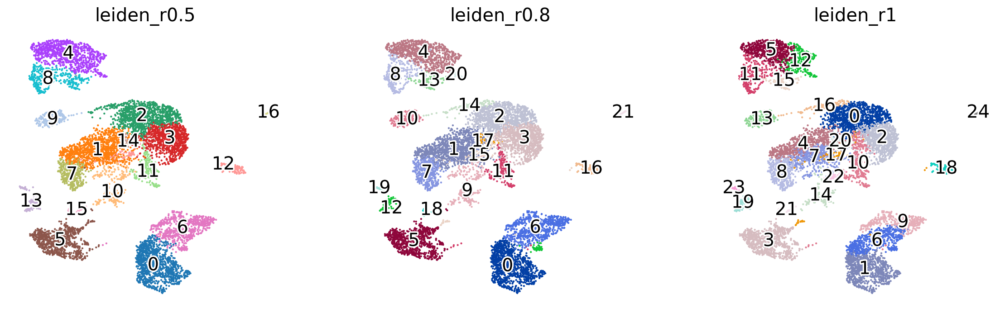

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_6_clustering_vst_hires.pdf"
sc.pl.umap(adata, color=['leiden_r0.5','leiden_r0.8','leiden_r1'], legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

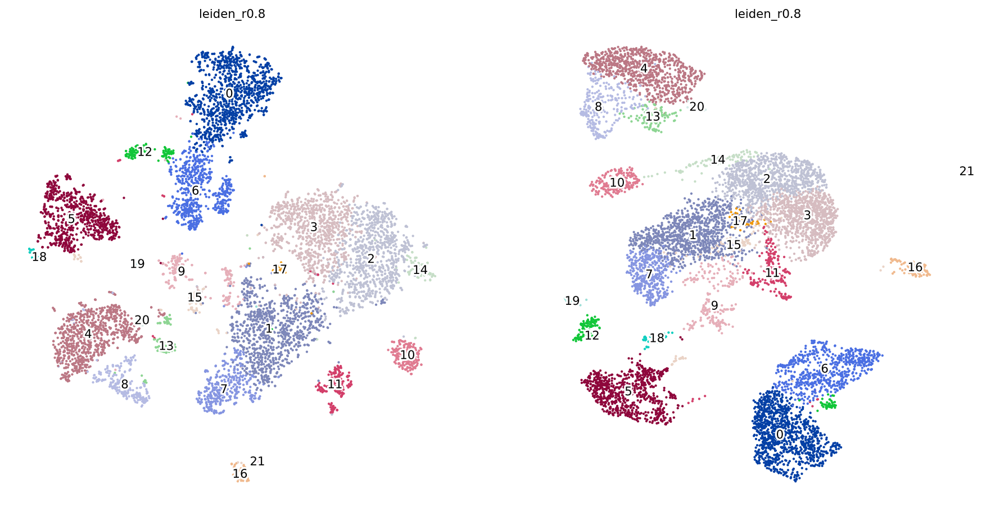

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2,) = plt.subplots(1, 2, figsize=(14,7), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.tsne(adata, color=['leiden_r0.8'], legend_loc='on data',vmin='p10',vmax='p99.9', legend_fontoutline=3,legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax1)
ax2_dict = sc.pl.umap(adata, color=['leiden_r0.8'], legend_loc='on data',legend_fontoutline=3,vmin='p10',vmax='p99.9', legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax2)
savefig='figures/'+samplename + 'QC_tsne_umap_leidenr0.8.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

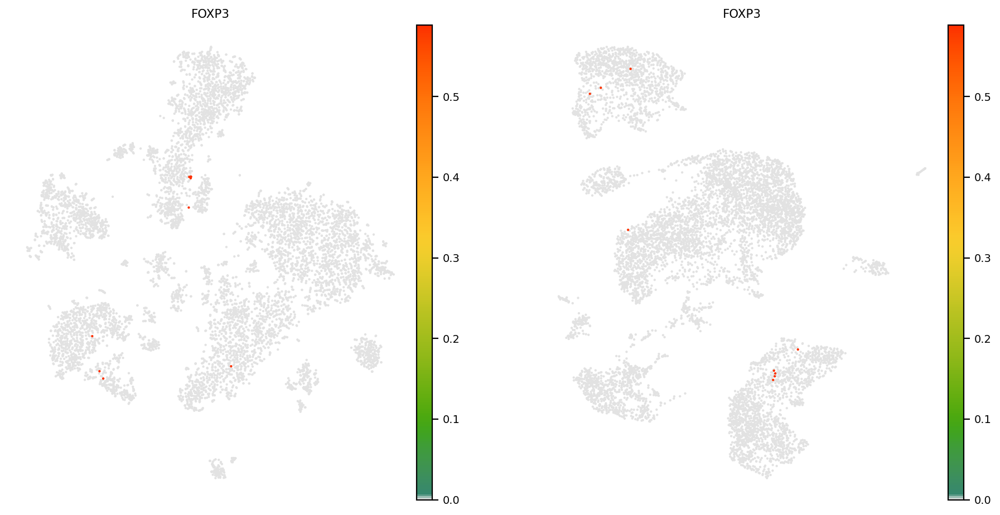

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2,) = plt.subplots(1, 2, figsize=(14,7), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.tsne(adata, color=['FOXP3'], legend_loc='on data',vmin='p10',vmax='p99.9', legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax1)
ax2_dict = sc.pl.umap(adata, color=['FOXP3'], legend_loc='on data',legend_fontoutline=3,vmin='p10',vmax='p99.9', legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax2)
savefig='figures/'+samplename + 'QC_tsne_umap_FOXP3.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden_r0.3', ['3']),key_added='leidenA')
sc.tl.leiden(adata, resolution=0.2, restrict_to=('leidenA', ['1']),key_added='leidenB')

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_7_clustering.pdf"
sc.pl.umap(adata, color=['leidenB'],legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

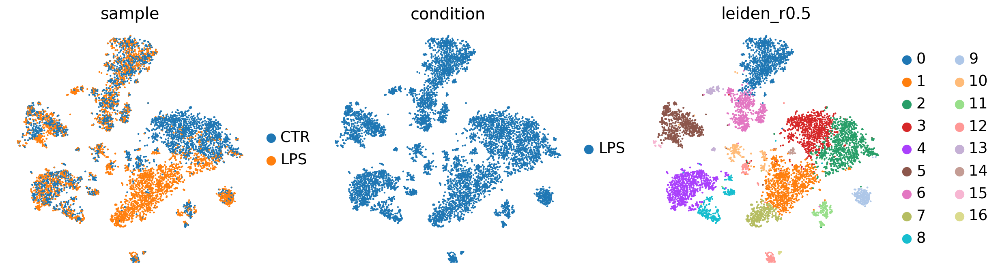

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_8_clustering_variables.pdf"
sc.pl.tsne(adata, color=['sample', 'condition', 'leiden_r0.5'], legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

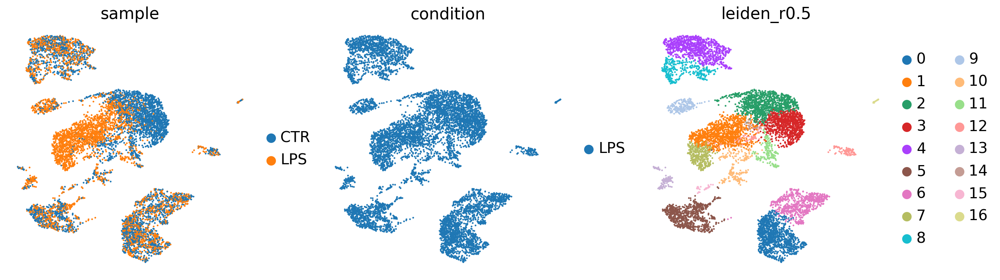

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_8_clustering_variables.pdf"
sc.pl.umap(adata, color=['sample', 'condition', 'leiden_r0.5'], legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

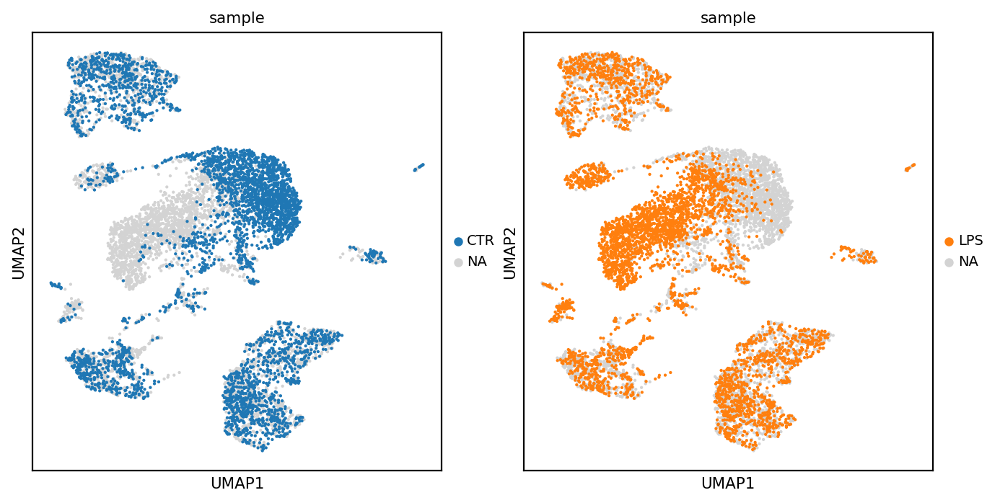

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2,) = pl.subplots(1, 2, figsize=(10,5), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.umap(adata, color='sample', groups=['CTR'], ax=ax1, show=False)
ax2_dict =  sc.pl.umap(adata, color='sample', groups=['LPS'], ax=ax2, show=False)
savefig='figures/'+samplename + '_9_dataintegration.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
#ax = sc.pl.umap(adata, size=10, show=False)
#sc.pl.umap(adata[adata.obs["donnor"] == "D1"],color=[ 'condition'],ax=ax)

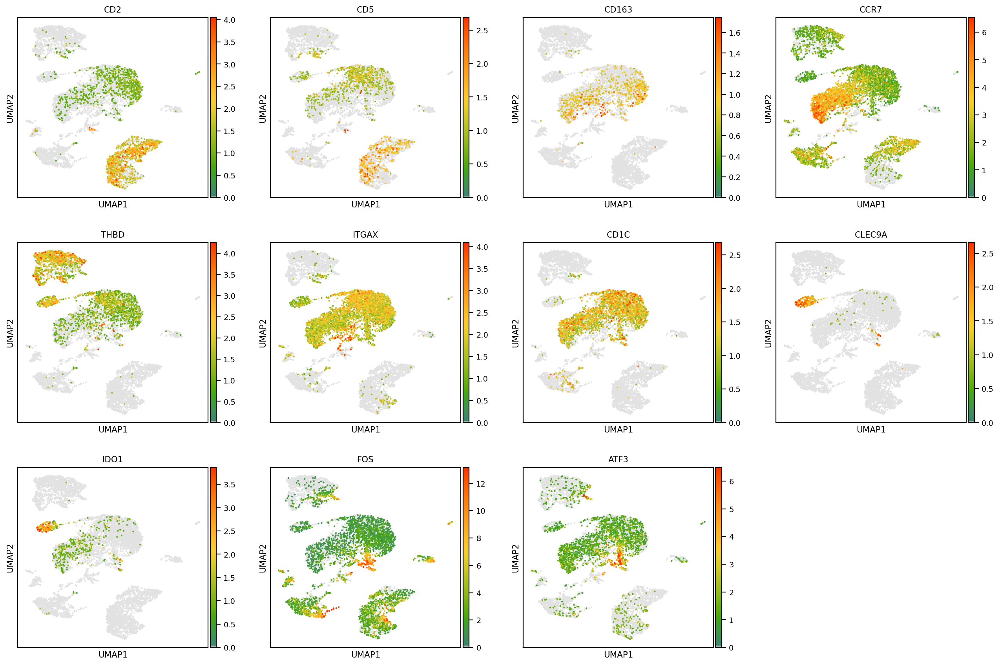

In [200]:
marker_genes = ['CD2','CD5','CD163','CCR7','THBD','ITGAX','CD1C','CLEC9A','IDO1','FOS','ATF3']
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_10_markers_4.pdf"
sc.pl.umap(adata=adata, color=marker_genes,color_map=mymap,vmin='p10', vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=False,layer="sqrt_norm", save=savefig)

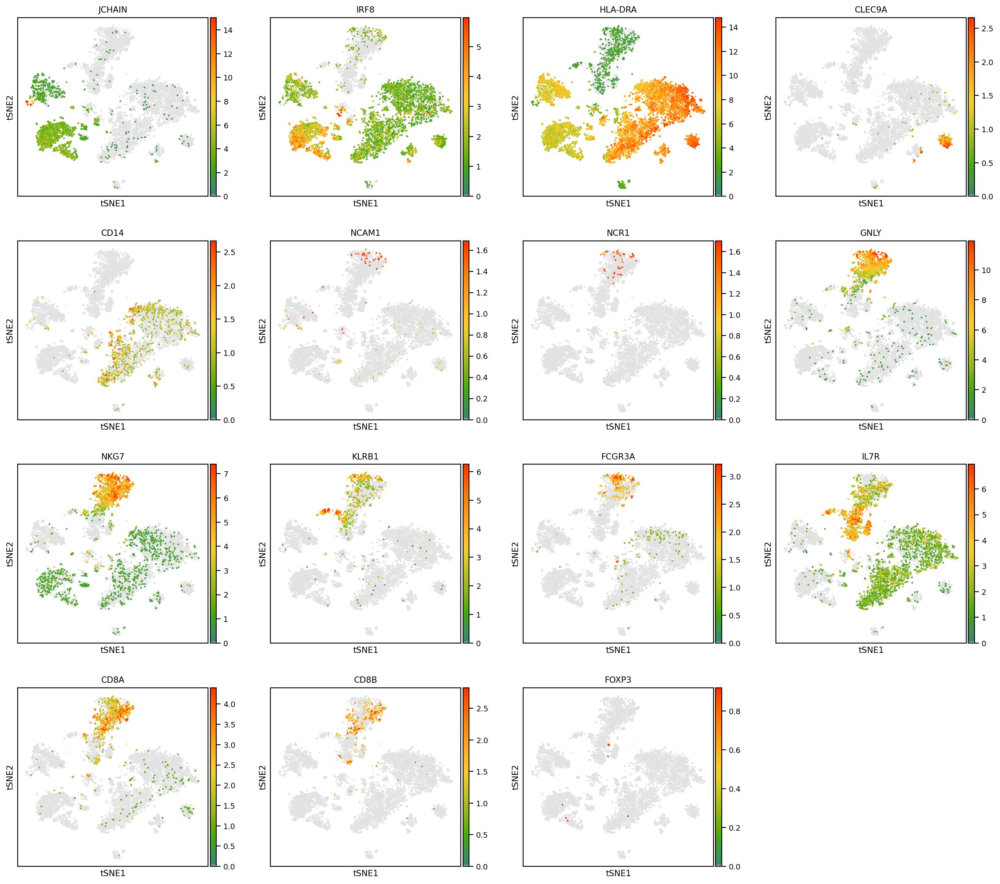

In [ ]:
marker_genes = ['JCHAIN','IRF8','HLA-DRA','CLEC9A','CD14','NCAM1','NCR1', 'GNLY', 'NKG7', 'KLRB1','FCGR3A','IL7R','CD8A', 'CD8B','FOXP3']
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_10_markers_1.pdf"
sc.pl.tsne(adata=adata, color=marker_genes,color_map=mymap,vmin='p10', vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=False,layer="sqrt_norm", save=savefig)

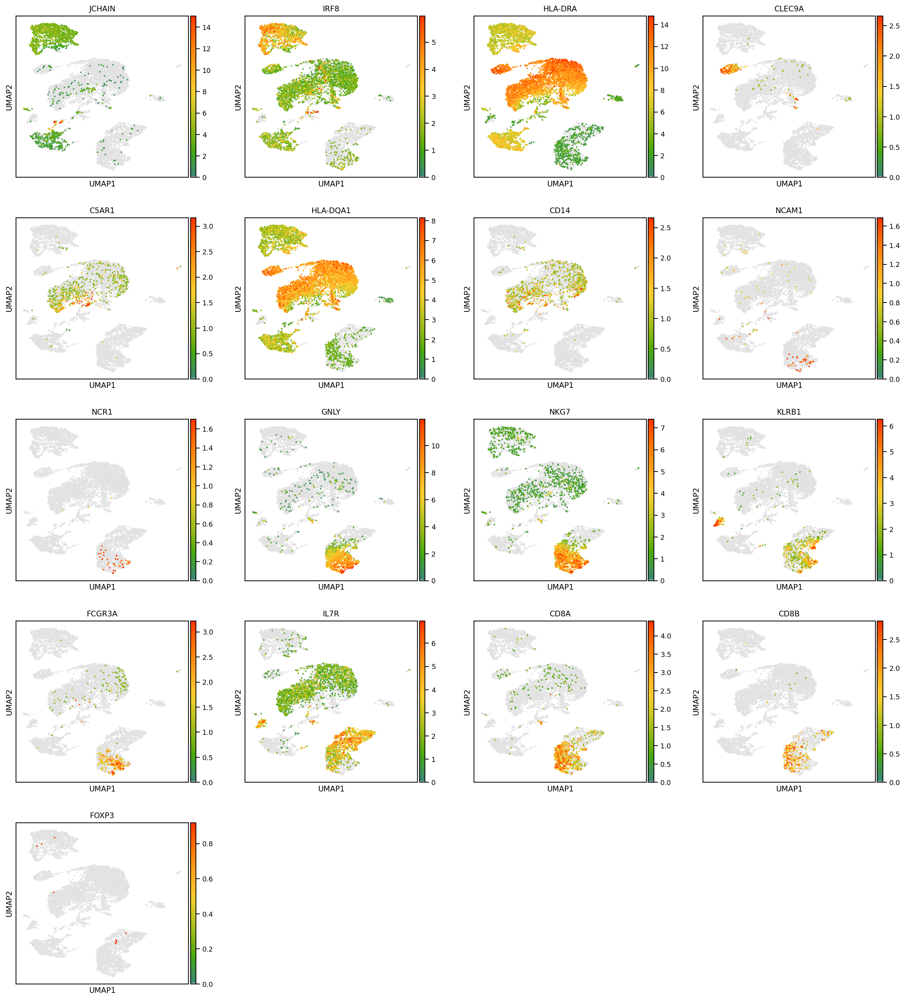

In [166]:
marker_genes = ['JCHAIN','IRF8','HLA-DRA','CLEC9A','C5AR1','HLA-DQA1','CD14','NCAM1','NCR1', 'GNLY', 'NKG7', 'KLRB1','FCGR3A','IL7R','CD8A', 'CD8B',]
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_10_markers_1.pdf"
sc.pl.umap(adata=adata, color=marker_genes,color_map=mymap,vmin='p10', vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=False,layer="sqrt_norm", save=savefig)

In [ ]:
cluster=samplename+"_cluster.h5ad"
adata.write(cluster)

In [ ]:
cluster=samplename+"_cluster.h5ad"
adata=sc.read(cluster)
adata

AnnData object with n_obs × n_vars = 8152 × 21057
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'condition_colors', 'hvg', 'leiden', 'leiden_r0.2_colors', 'leiden_r0.3_colors', 'leiden_r0.4_colors', 'leiden_r0.5_colors', 'leiden_r0.8_colors', 'leiden_r1_colors', 'neig

# Automatic annotation

In [ ]:
import cello

In [ ]:
sc.tl.leiden(adata, resolution=1.5)

In [ ]:
adata.X = adata.X.todense()

In [ ]:
adata.var_names_make_unique()
adata.var_names_make_unique()

In [ ]:
model_prefix = "DCLPS" # <-- The trained model will be stored in a file called GSM3516666_LX682_NORMAL.model.dill 

cello.scanpy_cello(
    adata, 
    'leiden',
    cello_resource_loc, 
    out_prefix=model_prefix
)

In [ ]:
model_prefix = "DCVitD3_CTR"

cello.scanpy_cello(
    adata, 
    'leiden',
    cello_resource_loc, 
    model_file=f'{model_prefix}.model.dill'
)

... storing 'Most specific cell type' as categorical


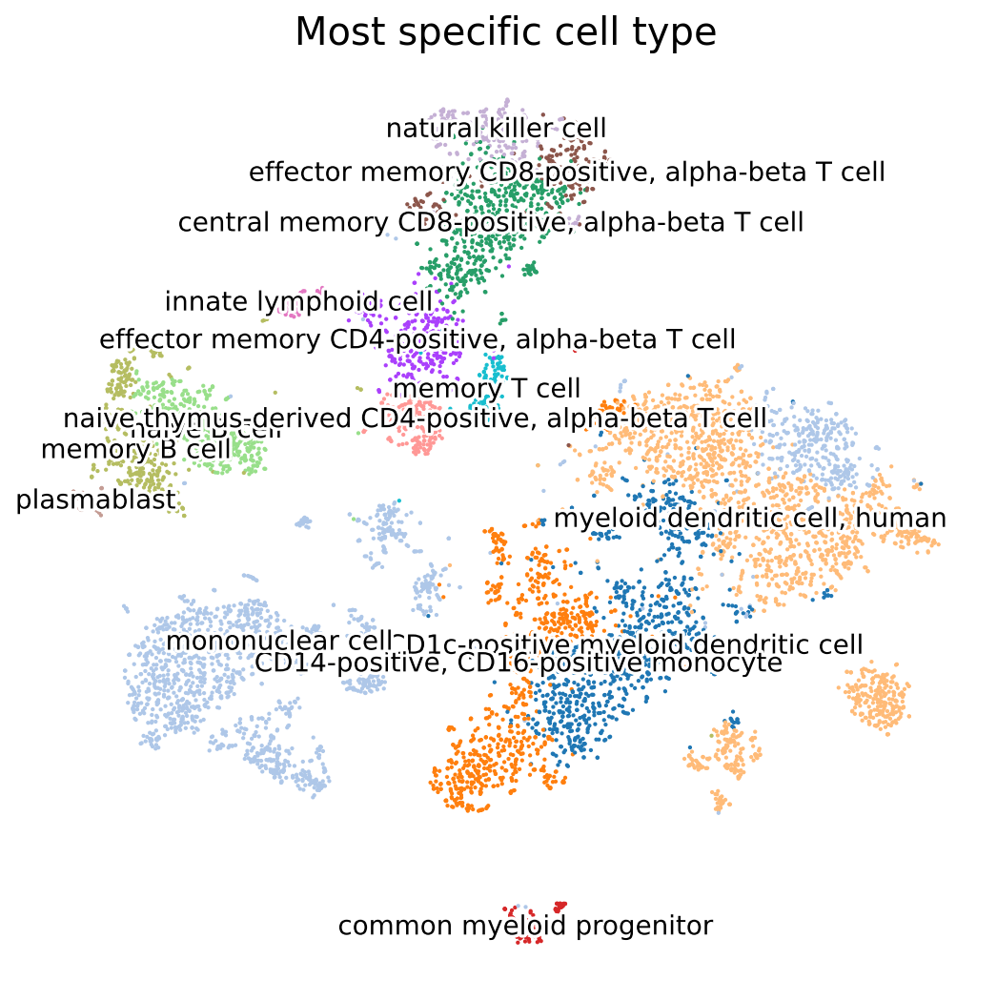

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(8,8)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.tsne(adata, color=['Most specific cell type'], legend_loc='on data',cmap=mymap,legend_fontoutline=3,vmax='p99.9',legend_fontsize='x-small', legend_fontweight='normal',frameon=False,save=savefig)

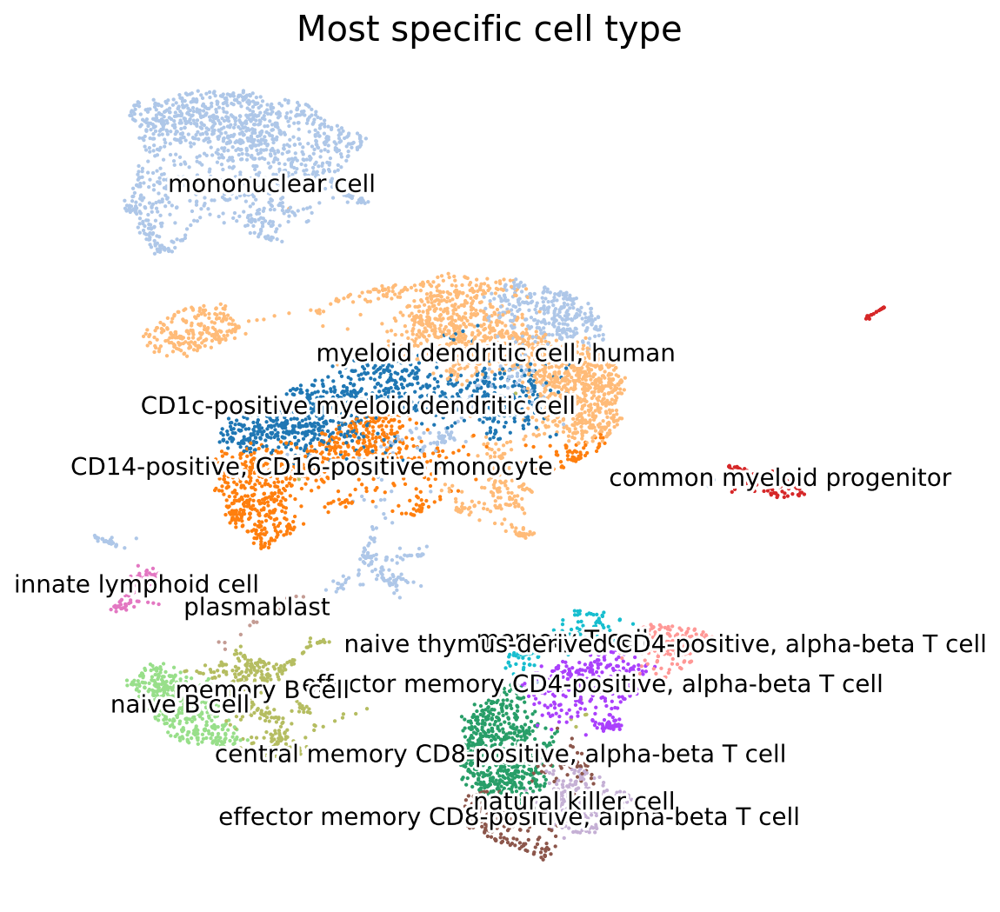

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(8,8)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.umap(adata, color=['Most specific cell type'], legend_loc='on data',cmap=mymap,legend_fontoutline=3,vmax='p99.9',legend_fontsize='x-small', legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
cluster=samplename+"_annotated.h5ad"
adata.write(cluster)

In [ ]:
cluster=samplename+"_annotated.h5ad"
adata=sc.read(cluster)
adata

AnnData object with n_obs × n_vars = 8152 × 21057
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2', 'leiden', 'early embryonic cell (probability)', 'cultured cell (probability)', 'germ line stem cell (probability)', 'male germ cell (probability)', 'male germ line stem cell (probability)', 'spermatocyte (probability)', 'spermatid (probability)', 'sperm (probability)', 'spermatogonium (probability)', 'female germ cell (probability)', 'oocyte (probability)', 'stem cell (probability)', 'single fate stem cell (probability)', 'epithelial fate 

In [ ]:
sc.pl.umap(adata, color='Most specific cell type', return_fig=True)

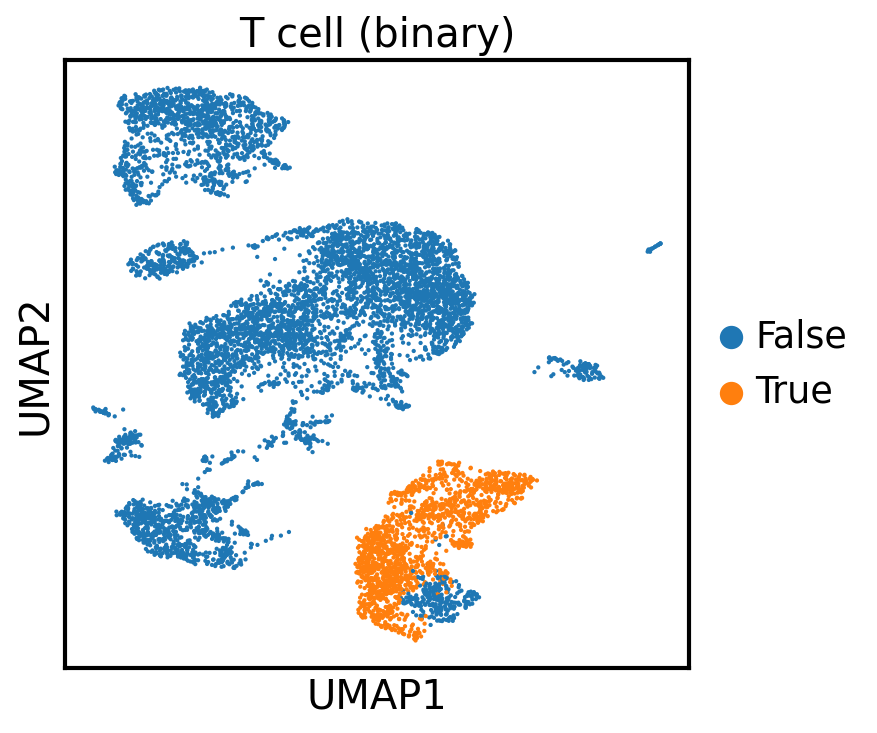

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata, color='T cell (binary)')

# load Nanopore data

In [ ]:
#nanopore=sc.read('Nanopore_cleam.h5ad')
nanopore=sc.read_text('/content/MyDrive/output_dir_constellation/sicmol_genematrix.txt').T
nanopore

AnnData object with n_obs × n_vars = 8856 × 9382

In [ ]:
#nanopore=sc.read('Nanopore_cleam.h5ad')
nanopore=sc.read_text('/content/MyDrive/output_dir_constellation/sicreadintermedia_genematrix.txt').T
nanopore

AnnData object with n_obs × n_vars = 8856 × 9366

In [ ]:
nanopore=sc.read_text('/content/MyDrive/output_dir_constellation/sicmol_isomatrix.txt').T
nanopore

In [ ]:
nanopore=sc.read_text('/content/MyDrive/output_dir_constellation/sicreadintermedia_isomatrix.txt').T
nanopore


# isoform level data

In [ ]:
nanopore = pd.read_csv('/content/MyDrive/output_dir_constellation/sicreadintermedia_isomatrix.txt', sep="\t", header=0)

In [193]:
nanopore = pd.read_csv('/content/MyDrive/output_dir_constellation/sicmol_isomatrix.txt', sep="\t", header=0)

In [194]:
nanopore

,geneId,transcriptId,nbExons,AATGAAGAGCGTTAGG,CACTGTCCACCTCGTT,GTGTTAGGTGTGAATA,TCATTCAGTCGCGTCA,AATCGACTCGGCATAT,GACCCAGGTTCCACGG,AGGGTGAAGTGGTTGG,CCCGGAAAGGCCTAAG,CCCTGATCATGACTAC,TGGGCGTGTCTGTGTA,TGCGACGCAATAACGA,AGGACTTCAAGATGGC,AGGATAAAGCGGTATG,CGTTAGAGTAGAGTTA,GCCATTCCATTGTACG,GGGACAAAGGTCGTCC,GTACAGTGTACGATGG,GTCAAACCAACAAGAT,TGCATCCTCTTGGTGA,TACCGAAGTTCAAAGA,GTTACAGAGGGTAATT,CATGGATGTTATAGAG,GCAACCGGTTCGTACA,AGTTAGCCAAGTGGTG,AGGTAGGTCCTATTGT,TATTGCTAGGAGTACC,GTAATGCAGTTGCCCG,CCGTTCACATGTACGT,TCGCTTGCACAAGCAG,TGTGGCGCATGACGGA,AGTCACATCCACCTCA,GGTTGTAGTTAGAGTA,AGCTCAAGTTTCGACA,TCGCTTGCACATATGC,CGGAACCCAGACAATA,TGCAGGCAGGGTGAAA,TTACCATGTCACCCTT,...,GTCTCACTCTTCCTAA,CTCCTCCAGATAGTCA,TTGCATTTCGCAATTG,CAACGGCAGTCTCGTA,GAAGCCCTCTTCGTGC,CCGGGTAGTAGCACAG,GAGTCATCAATTGCAC,AACAAAGTCAGGGATG,ATCGCCTAGATTGTGA,CACTTCGTCGTTCTGC,CTGTAGAGTAGAGGAA,CGATGCGAGATGCTTC,ATGGAGGAGATCGACG,GTAATGCCAGGACGAT,TCACATTCAACAGAGC,CATGCCTTCCGAAGGA,AATGCCATCAAGGAGC,GGCTTGGGTCAGTCCG,TCCATCGGTCGAGATG,CCATCACGTCGGTGAA,TCATGTTAGAAATGGG,ATTCCTACAAAGCTCT,ATACCTTTCAAGTGGG,TTAGGGTGTCCGTTTC,TTCCTTCAGAGGATGA,ATCGGCGGTAAGTAGT,GGCTTTCTCCTTCAGC,GACTTCCAGCAAGTGC,CCGGTAGGTTGTGGAG,AGTGATCGTGCCCGTA,ATCCTATTCAGTAGGG,CCGATGGTCCACATAG,ACTGATGGTTTCGGCG,ATCGTGAAGAGTTGTA,TCAAGTGGTCTCCCTA,CATGGATTCGATAACC,CTGAGCGGTCGAGCTC,CATTGTTCATCACCAA,CGTAAGTAGAGAGCGG,TGATGGTCAAGTGGGT
0,CHCHD10,undef,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,HRK,undef,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,NAA38,undef,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,PNP,ENST00000361505.9,6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,SRP9,ENST00000304786.11,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13609,UFD1,ENST00000263202.15,12,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
13610,CASP5,undef,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
13611,PLCL2,undef,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
13612,GALK2,undef,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [195]:
nanopore.insert(0, 'geneid', (nanopore[['geneId', 'transcriptId']].agg('.'.join, axis=1)))

In [196]:
nanopore = nanopore.drop('geneId', 1)
nanopore = nanopore.drop('transcriptId', 1)
nanopore = nanopore.drop('nbExons', 1)

In [197]:
nanopore=nanopore.set_index(['geneid'])

In [198]:
import anndata
obs = pd.DataFrame()
obs['barcode'] = nanopore.columns
var_names = nanopore.index
# dataframe for annotating the variables
var = pd.DataFrame(index=var_names)
# the data matrix 
X = nanopore.T.values
nanopore = anndata.AnnData(X, obs=obs, var=var, dtype='int32')
nanopore


/usr/local/lib/python3.7/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 8856 × 13614
    obs: 'barcode'

In [199]:
nanopore.obs=nanopore.obs.set_index(['barcode'])

# process nanopore data

In [ ]:
nanopore.var['nanopore']='_nanopore'

In [ ]:
nanopore.var['GeneID']=nanopore.var_names.astype(str) + nanopore.var['nanopore']


In [ ]:
nanopore.var.drop(['nanopore'], axis=1)

,GeneID
C3,C3_nanopore
JRK,JRK_nanopore
WAS,WAS_nanopore
RPS6KA5,RPS6KA5_nanopore
AC008149.2,AC008149.2_nanopore
...,...
LINC02076,LINC02076_nanopore
LINC01004,LINC01004_nanopore
TMBIM1,TMBIM1_nanopore
TMEM51,TMEM51_nanopore


In [ ]:
nanopore.var.index = nanopore.var["GeneID"]
nanopore.var = nanopore.var.drop('GeneID', 1)

In [ ]:
nanopore.var

,nanopore
GeneID,
C3_nanopore,_nanopore
JRK_nanopore,_nanopore
WAS_nanopore,_nanopore
RPS6KA5_nanopore,_nanopore
AC008149.2_nanopore,_nanopore
...,...
LINC02076_nanopore,_nanopore
LINC01004_nanopore,_nanopore
TMBIM1_nanopore,_nanopore


In [ ]:
adata.obs

In [201]:
nanopore=nanopore[nanopore.obs_names.isin(adata.obs.index)].copy()
nanopore

AnnData object with n_obs × n_vars = 8152 × 13614

In [202]:
nanopore.layers['counts']=nanopore.X

In [203]:
# Quality control - calculate QC covariates
nanopore.obs['n_counts'] = nanopore.X.sum(1)
nanopore.obs['log_counts'] = np.log(nanopore.obs['n_counts'])
nanopore.obs['n_genes'] = (nanopore.X > 0).sum(1)

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [204]:
sc.pp.calculate_qc_metrics(
    nanopore,
    percent_top=(5, 10, 15),
    var_type="nanopore",
    inplace=True,
)

/usr/local/lib/python3.7/site-packages/scanpy/preprocessing/_qc.py:422: RuntimeWarning: invalid value encountered in true_divide
  return values / sums[:, None]


In [205]:
nanopore.obs['n_counts'].sum()

504696

In [206]:
nanopore.obs['sample']=adata.obs['sample']

/usr/local/lib/python3.7/site-packages/scanpy/preprocessing/_normalization.py:183: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


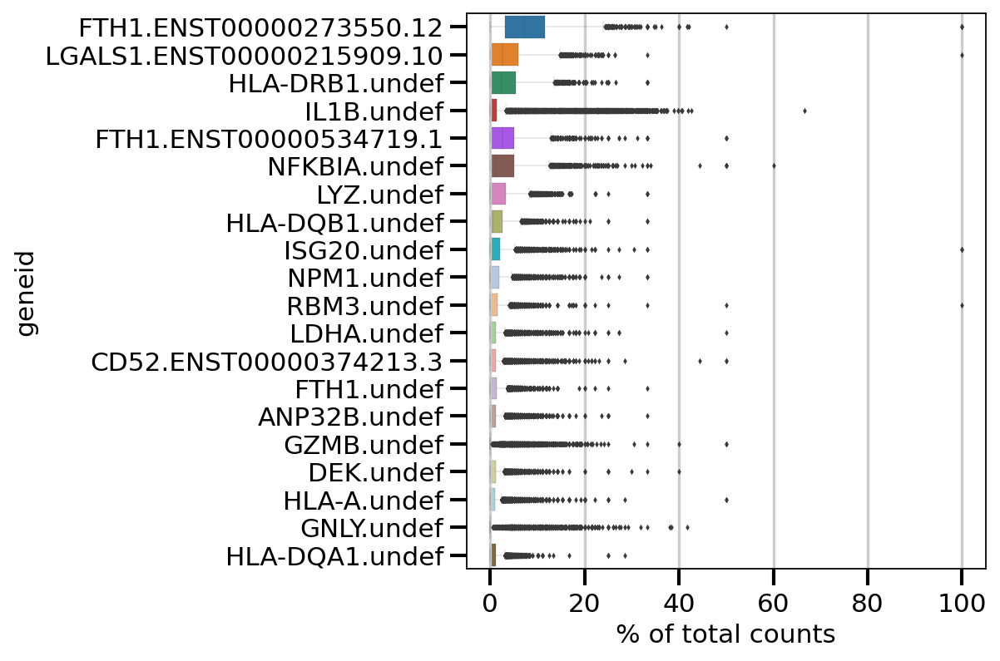

In [207]:
sb.set_context('talk')
pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
sc.pl.highest_expr_genes(nanopore, n_top=20,save='top20_nanopore.pdf' )

In [ ]:
pwd

'/content/MyDrive/Constellation/Aligned'

In [ ]:
nanopore.var

,nanopore,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
GeneID,,,,,,,
C3_nanopore,_nanopore,1,0.000123,0.000123,99.987733,1.0,0.693147
JRK_nanopore,_nanopore,0,0.000000,0.000000,100.000000,0.0,0.000000
WAS_nanopore,_nanopore,42,0.005152,0.005139,99.484789,42.0,3.761200
RPS6KA5_nanopore,_nanopore,7,0.000859,0.000858,99.914132,7.0,2.079442
AC008149.2_nanopore,_nanopore,7,0.000859,0.000858,99.914132,7.0,2.079442
...,...,...,...,...,...,...,...
LINC02076_nanopore,_nanopore,3,0.000368,0.000368,99.963199,3.0,1.386294
LINC01004_nanopore,_nanopore,2,0.000245,0.000245,99.975466,2.0,1.098612
TMBIM1_nanopore,_nanopore,6,0.000736,0.000736,99.926398,6.0,1.945910


In [ ]:
#sc.pl.violin(adata, ['B2M'],groupby='sample',)

In [ ]:
# Store the full data set in 'raw' as log-normalised data for statistical testing
#adata.raw = adata

In [208]:
sc.pp.normalize_total(nanopore)
sc.pp.log1p(nanopore)

/usr/local/lib/python3.7/site-packages/scanpy/preprocessing/_normalization.py:183: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


In [209]:

sc.pp.pca(nanopore, n_comps=10)
sc.pp.neighbors(nanopore, n_neighbors=10)  # why can't we just work with the default neighbors?
sc.tl.leiden(nanopore, key_added="nanopore_leiden")

In [210]:
sc.tl.umap(nanopore)

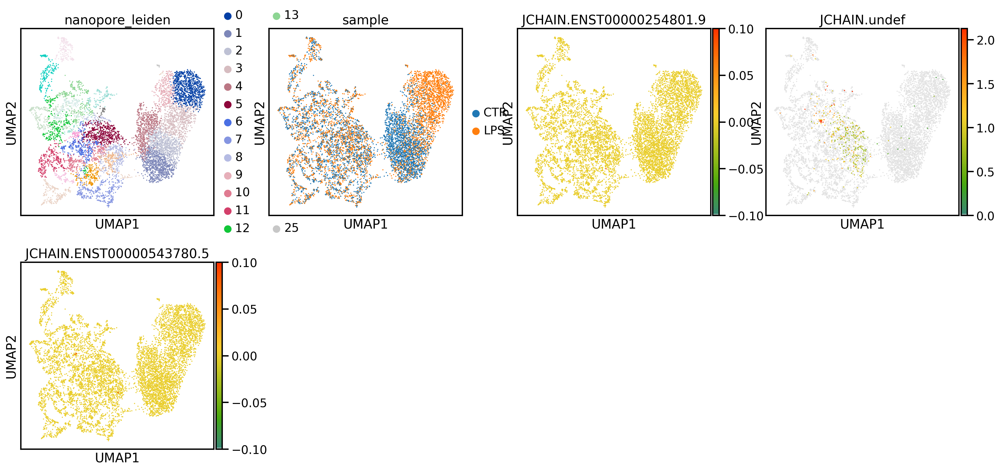

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
sc.pl.umap(nanopore, color=["nanopore_leiden",'sample','JCHAIN.ENST00000254801.9', 'JCHAIN.undef', 'JCHAIN.ENST00000543780.5'],cmap=mymap,vmax='p99.9', size=10)

In [211]:
# add gex to nanopore
nanopore.obsm['RNA_umap'] = adata[nanopore.obs.index].obsm['X_umap']
nanopore.obs['rna_leiden'] = adata.obs.loc[nanopore.obs.index, 'leiden_r0.2']


In [ ]:
nanopore.write('nanopore_gene.h5ad')

... storing 'nanopore' as categorical


In [212]:
nanopore.write('nanopore_isoform.h5ad')

In [ ]:
pwd

'/content/MyDrive/Constellation/Aligned'

In [ ]:
adata.obs

In [ ]:
nanopore.obs

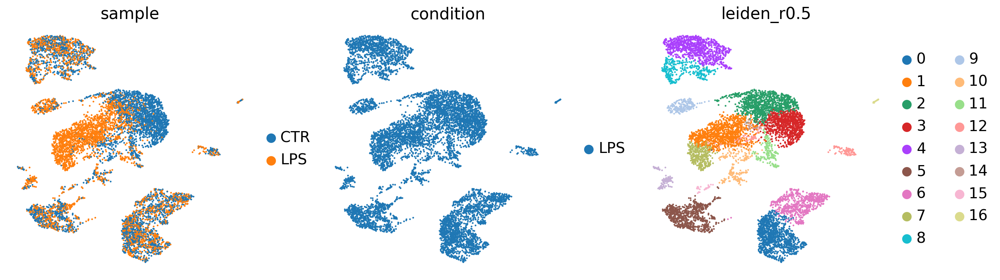

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_8_clustering_variables.pdf"
sc.pl.umap(adata, color=['sample', 'condition', 'leiden_r0.5'], legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

In [163]:
genes=['JCHAIN_nanopore','IRF8_nanopore','HLA-DRA_nanopore','CLEC9A_nanopore','C5AR1_nanopore','HLA-DQA1_nanopore','CD14_nanopore','NCAM1_nanopore','NCR1_nanopore', 'GNLY_nanopore', 'NKG7_nanopore', 'KLRB1_nanopore','FCGR3A_nanopore','IL7R_nanopore','CD8A_nanopore', 'CD8B_nanopore']

In [165]:
pwd

'/content/MyDrive/Constellation/Aligned'

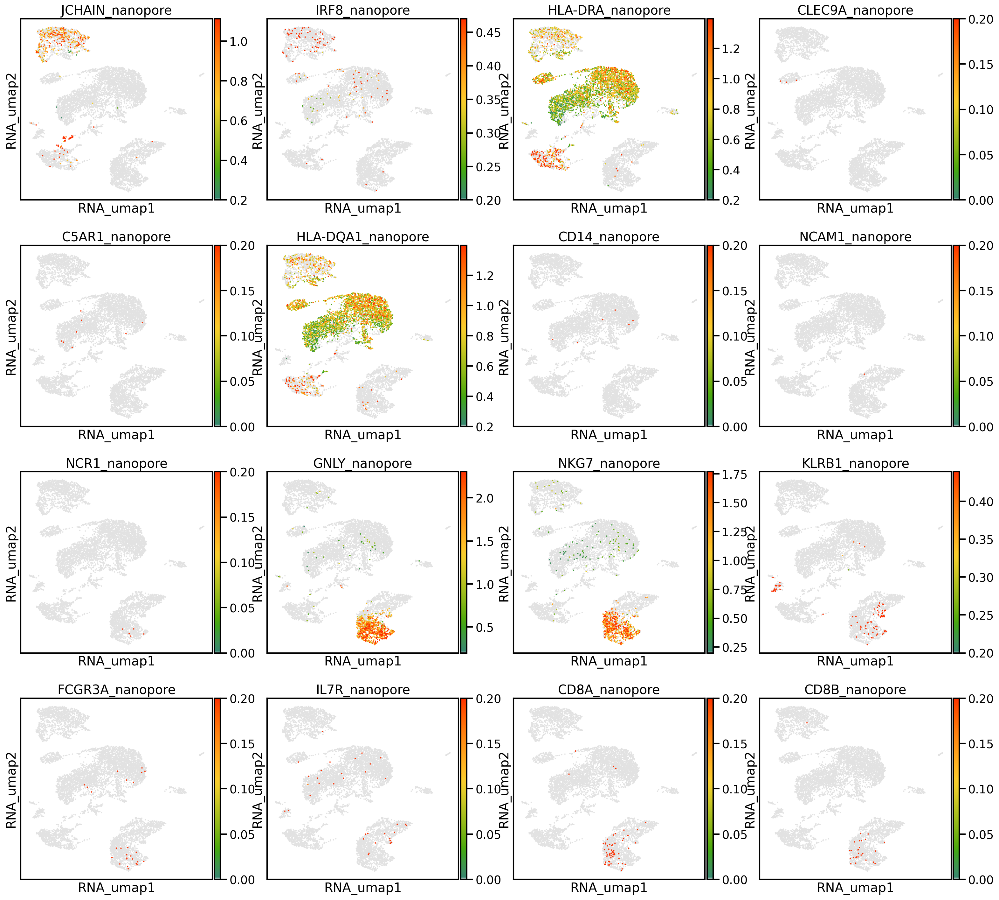

In [164]:
# now, let's plot the cite-seq information on top of the rna clusters
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)

f=sc.pl.embedding(nanopore, 'RNA_umap', color=genes,sort_order=True, ncols=4, return_fig=True, color_map=mymap, use_raw=False,vmin='0.2', vmax='p99', legend_fontsize=8)
f.savefig('Nanopore_2.pdf')

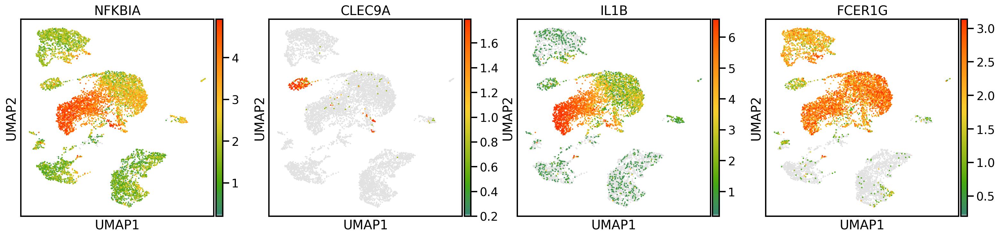

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata, color=genes,sort_order=True, ncols=4, color_map=mymap, use_raw=False,vmin='0.2', vmax='p99', legend_fontsize=8)


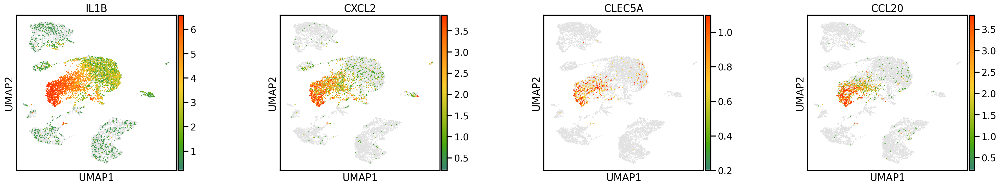

In [192]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata, color=['IL1B','CXCL2','CLEC5A','CCL20'],sort_order=True, ncols=4,hspace=0.5,wspace=0.5, color_map=mymap, use_raw=False,vmin='0.2', vmax='p99', legend_fontsize=8)


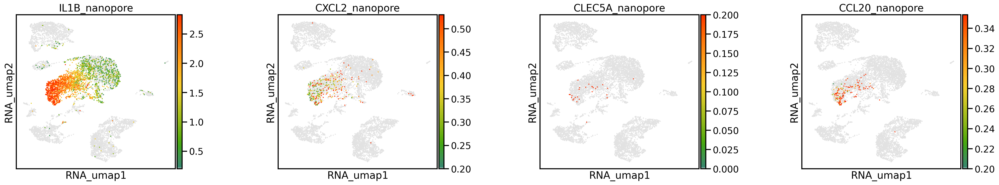

In [191]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
sc.pl.embedding(nanopore, 'RNA_umap',  color=['IL1B_nanopore','CXCL2_nanopore','CLEC5A_nanopore','CCL20_nanopore'],hspace=0.5,wspace=0.5,sort_order=True, ncols=4, color_map=mymap, use_raw=False,vmin='0.2', vmax='p99', legend_fontsize=8)

In [ ]:
# now, let's plot the cite-seq information on top of the rna clusters
f=sc.pl.embedding(nanopore, 'RNA_umap', color=genes,sort_order=True, ncols=4, return_fig=True, color_map=mymap, use_raw=False,vmin='p5', vmax='p99.9', legend_fontsize=8)
f.savefig('Nanopore.pdf')

In [ ]:
regex = re.compile('^(JCHAIN).*', re.IGNORECASE)
genes = [l for l in nanopore.var_names for m in [regex.search(l)] if m]
genes

['JCHAIN_nanopore']

In [ ]:
genes=[
 'KIR2DS4_undef_nanopore','KIR2DL3_undef_nanopore']

In [ ]:
sb.set_context('paper')
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_annotated_1.pdf"
sc.pl.umap(adata, color=genes,vmin='p10', vmax='p99.9',cmap=mymap,legend_fontoutline=3,legend_loc='on data', legend_fontweight='normal',frameon=False,save=savefig)

# Marker genes

# Long reads

In [167]:
# add gex to nanopore

nanopore.obs['rna_leiden'] = adata.obs.loc[nanopore.obs.index, 'leiden_r0.3']

In [218]:
nanopore.obs['annotated'] = adata.obs.loc[nanopore.obs.index, 'annotated']

In [219]:


#method : {‘logreg’, ‘t-test’, ‘wilcoxon’, ‘t-test_overestim_var’} | None (default: None)
sc.tl.rank_genes_groups(nanopore, 'annotated', method='wilcoxon',n_genes=adata.shape[1])
markers=pd.DataFrame(nanopore.uns['rank_genes_groups']['names']).head(50)
markers

,pDC,DC1,DC2_CTR,DC2_LPS,Bcells,DC_unknown,NKcells,Tcells,Mono,preDC?,innate lymphoid cells,Platelet,unknown
0,GZMB.undef,HLA-DRB1.undef,LYZ.undef,IL1B.undef,CD52.ENST00000374213.3,LYZ.undef,GNLY.undef,GIMAP7.undef,S100A8.ENST00000477801.1,JCHAIN.undef,GIMAP7.undef,NPM1.undef,PRG2.undef
1,LILRA4.undef,LYZ.undef,FTH1.ENST00000273550.12,NFKBIA.undef,CD69.undef,NFKBIA.undef,CCL5.undef,TRAT1.undef,S100A9.undef,MZB1.ENST00000302125.8,KLRB1.undef,ANP32B.undef,ANP32B.undef
2,SPIB.undef,HLA-DQB1.undef,LGALS1.ENST00000215909.10,IL1RN.undef,CD37.undef,FOS.ENST00000555347.1,NKG7.ENST00000221978.10,NPM1.undef,S100A12.undef,TNFRSF17.ENST00000053243.6,IFITM1.ENST00000408968.4,RPL26.ENST00000648839.1,CLC.ENST00000221804.5
3,MIF.ENST00000215754.8,HLA-DQA1.undef,HLA-DRB1.undef,IER3.undef,MS4A1.undef,HLA-DRB1.undef,GZMH.undef,IL32.ENST00000525003.1,LYZ.undef,IGKC.ENST00000390237.2,IL32.ENST00000525003.1,VPS28.undef,CKS2.ENST00000314355.7
4,JCHAIN.undef,HLA-DRA.undef,FTH1.ENST00000534719.1,CCL3.ENST00000613922.2,CD55.undef,IL1B.undef,LDHA.undef,CD3D.ENST00000300692.8,CFD.undef,IGKJ2.undef,CTSW.undef,MIF.ENST00000215754.8,MS4A2.undef
5,PTGDS.ENST00000371625.8,HLA-DPB1.undef,HLA-DQB1.undef,BCL2A1.ENST00000267953.4,TNFRSF13C.undef,HLA-DQB1.undef,HLA-A.undef,IFITM1.ENST00000408968.4,BCL2A1.ENST00000267953.4,PDIA4.undef,CD7.undef,AL157895.1.undef,EGR1.undef
6,FCER1G.ENST00000289902.2,HLA-DPA1.undef,HLA-DQA1.undef,LYZ.undef,CD52.undef,HLA-DQA1.undef,XCL2.undef,CD2.undef,CD68.undef,FKBP11.ENST00000550765.6,GATA3.undef,RBM3.undef,NPM1.undef
7,CLEC4C.undef,FTH1.ENST00000534719.1,HLA-DRA.undef,TNFAIP3.undef,TNFRSF13B.undef,YME1L1.undef,APOBEC3G.undef,SKAP1.undef,LILRB3.ENST00000460208.1,LINC01781.undef,IL27RA.undef,ITGA4.undef,ITGA4.undef
8,SELENOS.ENST00000527833.5,CD74.undef,FTH1.undef,S100A9.undef,LTB.ENST00000429299.2,HLA-DRA.undef,CTSW.undef,TSHZ2.undef,CCL3.ENST00000613922.2,MZB1.undef,TNFRSF18.ENST00000486728.5,CKS2.ENST00000314355.7,CSF1.undef
9,RBM3.undef,TXN.ENST00000374517.6,S100A9.undef,BCL2A1.undef,CKS2.ENST00000314355.7,FTH1.undef,GZMB.undef,IL27RA.undef,LILRB3.undef,ITGA4.undef,SKAP1.undef,ZNF428.undef,TXN.ENST00000374517.6


# Short Reads

In [220]:
#method : {‘logreg’, ‘t-test’, ‘wilcoxon’, ‘t-test_overestim_var’} | None (default: None)
sc.tl.rank_genes_groups(adata, 'annotated', method='logreg',n_genes=adata.shape[1])
markers=pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(50)
markers

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


,pDC,DC1,DC2_CTR,DC2_LPS,Bcells,DC_unknown,NKcells,Tcells,Mono,preDC?,innate lymphoid cells,Platelet,unknown
0,PPP1R14B,TACSTD2,CXCL10,IL1B,IGHM,FOS,GNLY,IL7R,S100A9,MTRNR2L12,KLRB1,GP1BB,PRG2
1,CLIC3,CPVL,IFI30,CXCL8,HLA-DRA,ATF3,NKG7,RCAN3,S100A8,MTRNR2L8,FXYD5,PPBP,HDC
2,GZMB,CPNE3,TIMP1,FTH1,IGKC,FOSB,CCL5,LTB,FCN1,MTRNR2L10,ANXA1,PRKAR2B,MS4A2
3,SERPINF1,C1orf54,TYROBP,VIM,CD79A,TIPARP,CST7,CD2,VCAN,IGHA1,TNFRSF18,CAVIN2,TPSAB1
4,HERPUD1,CLEC9A,HLA-DQA1,TPT1,FADS3,HSPA1A,CMC1,BTG1,LYZ,MTRNR2L1,S100A11,NRGN,LMO4
5,SEC61B,SNX3,CXCR4,CCL3,MS4A1,DUSP2,LDHA,SPOCK2,S100A12,BTG1,LMNA,GPX4,GLUL
6,ALOX5AP,TXN,ZEB2,EEF1A1,CD74,ZFP36,GZMH,FTH1,C5AR1,HNRNPA2B1,SOX4,SERPINB1,MS4A3
7,C12orf75,GPR157,LACTB,IER3,CD83,HSPA1B,ZEB2,PABPC1,ATP2B1-AS1,NEAT1,DDIT4,PF4,NR4A3
8,PMEPA1,THBD,SERPINB1,HLA-DRA,RALGPS2,DUSP1,APOBEC3G,TPT1,AC020656.1,SRRM2,TSC22D3,SLC40A1,CD63
9,IL3RA,OAZ2,HLA-DPA1,IL1RN,WDR66,JUNB,DUSP2,FYB1,CTSS,WDR66,FOS,HIST1H2AC,NR4A1


In [ ]:
savetable=samplename+"_marker_genes_leiden_r0.5.csv"
markers.to_csv(savetable)

# Johnathan Differential expresed isoforms in Platelets using ShortReads

In [229]:
platelets_short= adata[adata.obs['annotated'].isin(['Platelet']),:].copy()
platelets_short

AnnData object with n_obs × n_vars = 90 × 21057
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2', 'leiden', 'early embryonic cell (probability)', 'cultured cell (probability)', 'germ line stem cell (probability)', 'male germ cell (probability)', 'male germ line stem cell (probability)', 'spermatocyte (probability)', 'spermatid (probability)', 'sperm (probability)', 'spermatogonium (probability)', 'female germ cell (probability)', 'oocyte (probability)', 'stem cell (probability)', 'single fate stem cell (probability)', 'epithelial fate st

In [230]:
sc.tl.rank_genes_groups(platelets_short, 'sample', method='t-test', groups= ['LPS'], reference='CTR',key_added = "wilcoxon")
#sc.tl.rank_genes_groups(adata, 'leiden_r1', method='t-test',key_added = "wilcoxon")
markers=sc.get.rank_genes_groups_df(platelets_short, group='LPS', key='wilcoxon',log2fc_min=5)
markers.head(20)

,names,scores,logfoldchanges,pvals,pvals_adj
0,SPDL1,3.300718,27.080727,0.001869,1.0
1,RECQL5,3.300718,27.080727,0.001869,1.0
2,RNF144A,2.985208,27.109560,0.004528,1.0
3,MX1,2.819039,27.356844,0.007081,1.0
4,FAM118B,2.779575,26.818583,0.007858,1.0
5,DESI1,2.779575,26.818583,0.007858,1.0
6,SLC25A45,2.594553,26.463261,0.012665,1.0
7,AL353807.5,2.594553,26.463261,0.012665,1.0
8,EXT1,2.594553,26.463261,0.012665,1.0
9,PIGZ,2.594553,26.463261,0.012665,1.0


# Johnathan Differential expresed isoforms in Platelets using LongReads 

In [222]:
platelets= nanopore[nanopore.obs['annotated'].isin(['Platelet']),:].copy()
platelets

AnnData object with n_obs × n_vars = 90 × 13614
    obs: 'n_counts', 'log_counts', 'n_genes', 'n_nanopore_by_counts', 'log1p_n_nanopore_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_nanopore', 'pct_counts_in_top_10_nanopore', 'pct_counts_in_top_15_nanopore', 'sample', 'nanopore_leiden', 'rna_leiden', 'annotated'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'leiden', 'umap', 'wilcoxon', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'RNA_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [226]:
sc.tl.rank_genes_groups(platelets, 'sample', method='t-test', groups= ['LPS'], reference='CTR',key_added = "wilcoxon")
#sc.tl.rank_genes_groups(adata, 'leiden_r1', method='t-test',key_added = "wilcoxon")
markers=sc.get.rank_genes_groups_df(platelets, group='LPS', key='wilcoxon',log2fc_min=4)
markers.head(20)

,names,scores,logfoldchanges,pvals,pvals_adj
0,AL590764.2.undef,2.300074,26.004637,0.026031,1.0
1,RPS19.ENST00000598742.5,2.055065,25.352793,0.045577,1.0
2,UBA52.ENST00000597451.5,2.030071,25.676573,0.048155,1.0
3,RPS16.ENST00000251453.8,2.018377,25.669476,0.049405,1.0
4,RPLP0.undef,2.005442,25.814165,0.050819,1.0
5,EEF2.undef,1.770221,25.111771,0.083318,1.0
6,IER3.undef,1.769613,25.332785,0.083420,1.0
7,HMGN3.undef,1.767434,25.273338,0.083789,1.0
8,TNFAIP8L1.undef,1.764710,25.211006,0.084251,1.0
9,COX20.undef,1.759911,25.224190,0.085072,1.0


# Known markers

In [ ]:
adata.obs['leiden_r1'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18'],
      dtype='object')

In [ ]:
adata.obs.annotated = adata.obs.leiden_r1.cat.reorder_categories([
'3','11','12','14','2','1','6','8','9','0','5','7','10','4','13','15','16', '17', '18' ])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  


In [ ]:
marker_genes_dict = {
    'pDC': ['JCHAIN','IRF8','PTPRS','RHEX',],
    'mregDC':['LAMP3','SLCO5A1','IDO1','MARCKS','CRLF2','MARCKSL1',],
    'DC3':['PLA2G7','ITGAX','FCER1G','PTPRE','DOCK4','LYZ','C15orf48','CYP1B1','STAB1','CYP27A1','GPR68','CD14'],
    'DC2':['SYT17','EDN1','CTLA4','INHBA','SPRED1','FMNL2','IL1RN',],
    'NK': ['GNLY','KLRD1','C1orf21','LINC00996','TXK','ZBTB16','NCAM1',],
    'T-cell': ['IL7R','CD3D','CD3G','LTB','CCL5','CD247'],
    'B-cell': ['CD79A', 'MS4A1','AFF3','IGKC','IGHM','BANK1']
}

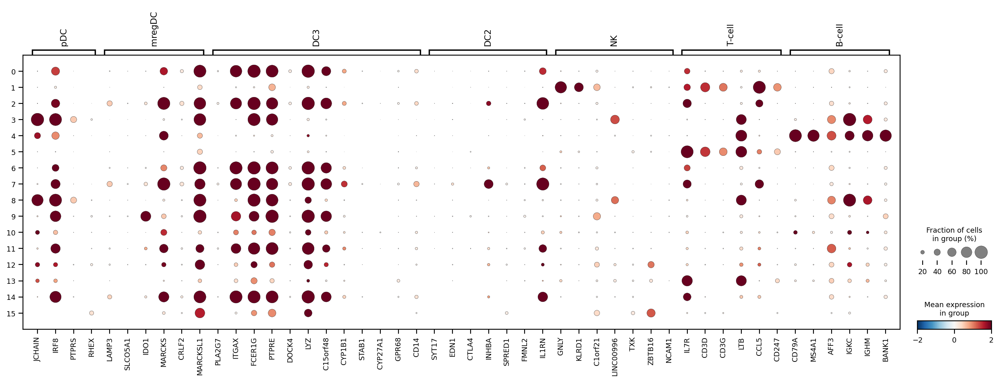

In [ ]:
sb.set_context('paper')
savefig=samplename+"_Dotplot_markers_all.pdf"
sc.pl.dotplot(adata, 
                  var_names=marker_genes_dict,
                  vmin=-2, vmax=2, cmap='RdBu_r', groupby='leiden_r0.5', return_fig=False, dendrogram=False,save=savefig)

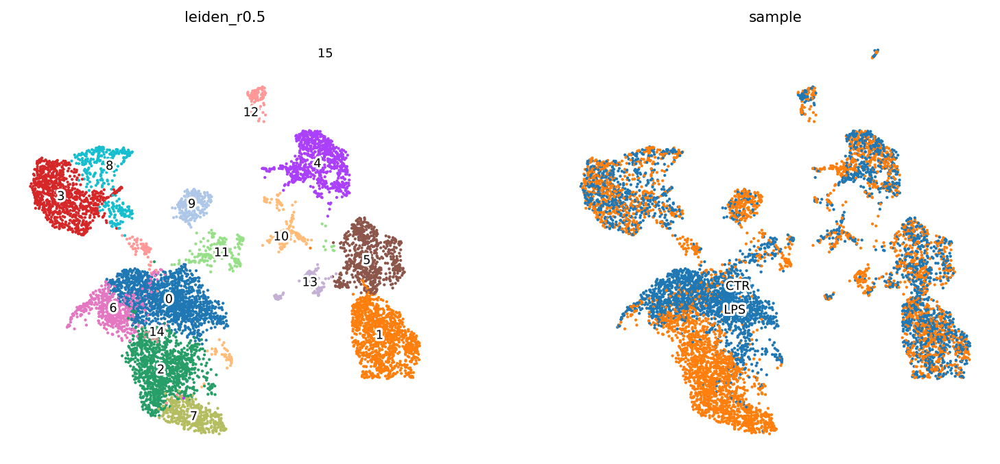

In [ ]:
sb.set_context('paper')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_clustering_hires_vst.pdf"
sc.pl.umap(adata, color=['leiden_r0.5','sample'], legend_loc='on data',legend_fontoutline=3,legend_fontsize='small', legend_fontweight='normal',frameon=False,save=savefig)

# Automatic annotation

In [ ]:
%cd /content/

/content


In [ ]:
!git clone https://github.com/LucasESBS/scoreCT

Cloning into 'scoreCT'...
remote: Enumerating objects: 197, done.
remote: Counting objects: 100% (12/12), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 197 (delta 3), reused 12 (delta 3), pack-reused 185
Receiving objects: 100% (197/197), 114.10 MiB | 47.63 MiB/s, done.
Resolving deltas: 100% (57/57), done.


In [ ]:
!cp /content/MyDrive/tools/covid200.gmt /content/scoreCT/src/

In [ ]:
# Import modules
import os
import sys
sys.path.append('/content/scoreCT/src')
import scorect_api as ct


In [ ]:

ref_marker = ct.read_markers_from_file('/content/scoreCT/src/covid200.gmt')


In [ ]:
# added `n_genes` to store information in all genes. This is needed if we want to plot log fold changes or pvalues
sc.tl.rank_genes_groups(adata, groupby='leidenB', n_genes=40, method='wilcoxon',corr_method="bonferroni")

In [ ]:
# Wrangle results from existing sc.tl.rank_genes_groups() results
# Let's have a look for cluster 0
marker_df = ct.wrangle_ranks_from_anndata(adata)
print(marker_df.head())

Wrangling: Number of markers used in ranked_gene_groups:  40
Wrangling: Groups used for ranking: leidenB
     z_score  adj_pvals   gene cluster_number
0  83.601303        0.0  BANK1              0
1  82.112808        0.0   EBF1              0
2  81.381256        0.0  MS4A1              0
3  79.247589        0.0   PAX5              0
4  78.316078        0.0  CD79A              0


In [ ]:

# Score cell types for each cluster 
# Let's set parameters first - K represents the number of genes included in the ranking
# m represents the number of bins used to divide the top K genes.
K = 100
m = 5
# Get the background genes - here, all the genes used to run the differential gene expression test
background = adata.raw.var.index.tolist()
# Now run the function
ct_pval, ct_score = ct.celltype_scores(nb_bins=m,
                                        ranked_genes=marker_df,
                                        K_top = K,
                                        marker_ref=ref_marker,
                                        background_genes=background)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


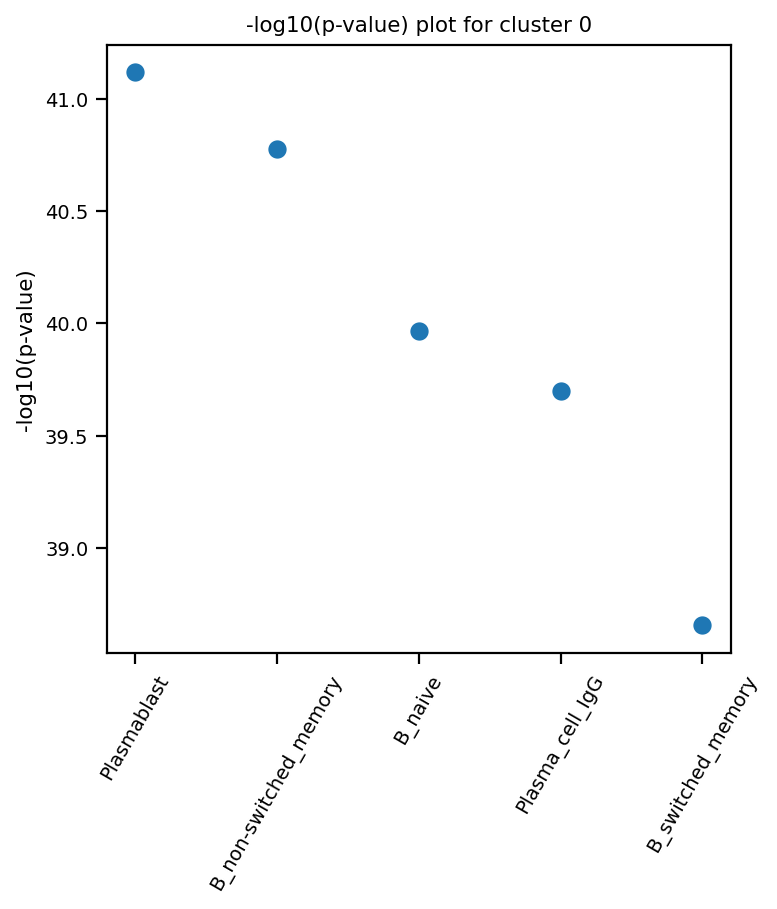

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


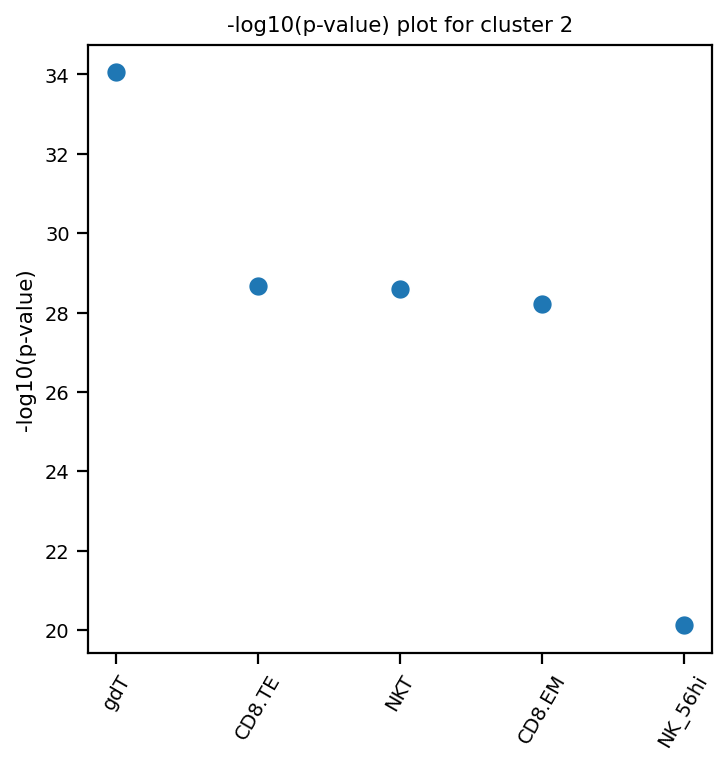

In [ ]:

# Let's have a look at the pvalue for cluster 0
ct.plot_pvalue(ct_pval, clusters=['0','2'], n_types=5)

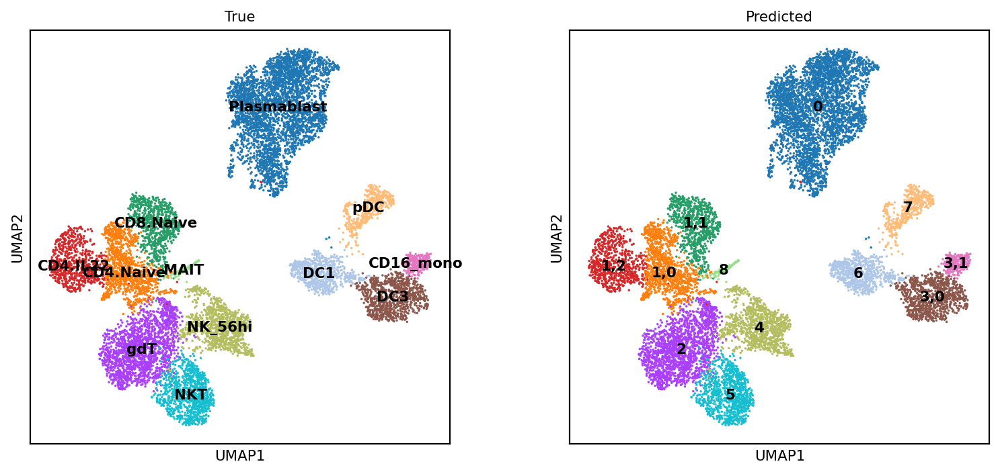

In [ ]:

# Now assign clusters to cell types
cluster_assign = adata.obs['leidenB']
celltype_assign = ct.assign_celltypes(cluster_assignment=cluster_assign, ct_pval_df=ct_pval, ct_score_df=ct_score, cutoff=0.01)
# Add to anndata object
adata.obs['scorect'] = celltype_assign
# Let's compare with the true assignment now! 
sc.pl.umap(adata, color=['scorect','leidenB'], title=['True','Predicted'], cmap='Set2',legend_loc='on data')


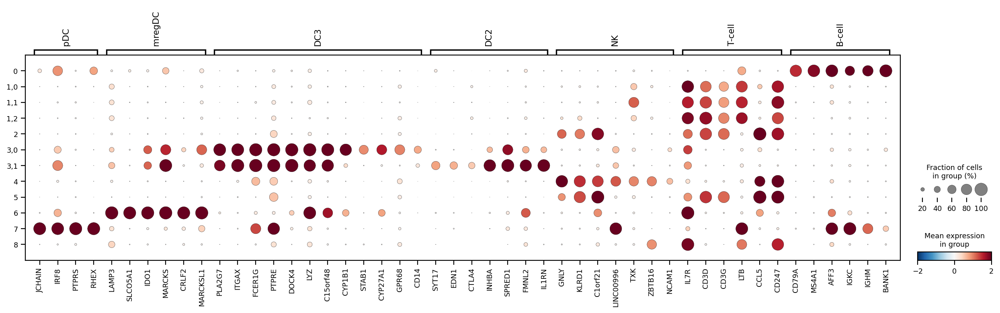

In [ ]:
sb.set_context('paper')
savefig=samplename+"_Dotplot_markers_all.pdf"
sc.pl.dotplot(adata, 
                  var_names=marker_genes_dict,
                  vmin=-2, vmax=2, cmap='RdBu_r', groupby='leidenB', return_fig=False, dendrogram=False,save=savefig)

# Annotattion

In [170]:
adata.obs['leiden_r0.3'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13'],
      dtype='object')

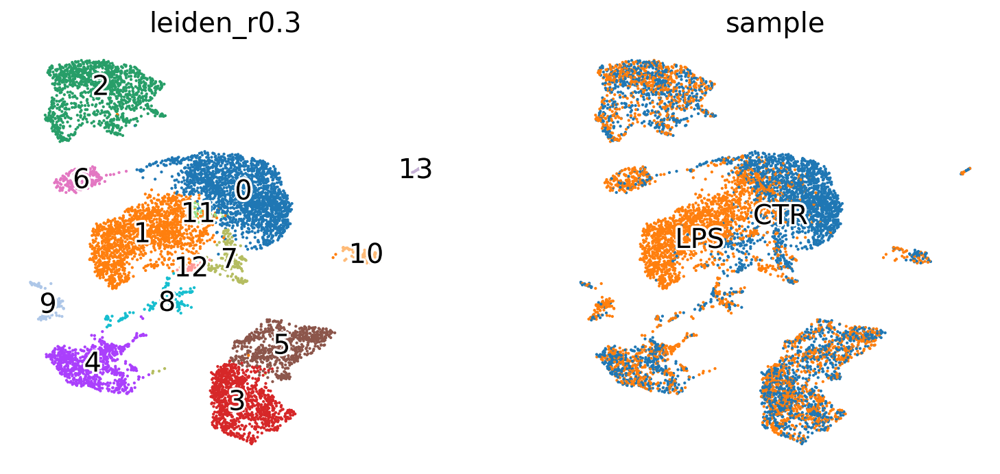

In [179]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_5_clustering_vst_lowres.pdf"
sc.pl.umap(adata, color=['leiden_r0.3','sample'], legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

In [183]:
adata.obs['annotated'] = adata.obs['leiden_r0.3'].cat.add_categories(['pDC','DC1','DC2_CTR','DC2_LPS','Bcells','DC_unknown','NKcells','Tcells','Mono','preDC?','innate lymphoid cells','Platelet','unknown'])

adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['2'])] = 'pDC'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['6',])] = 'DC1'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['0','11'])] = 'DC2_CTR'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['1'])] = 'DC2_LPS'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['4'])] = 'Bcells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['3'])] = 'NKcells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['5'])] = 'Tcells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['12'])] = 'Mono'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['8'])] = 'preDC?'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['9'])] = 'innate lymphoid cells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['10'])] = 'Platelet'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['13'])] = 'unknown'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['7'])] = 'DC_unknown'

adata.obs['annotated'] = adata.obs['annotated'].cat.remove_unused_categories()

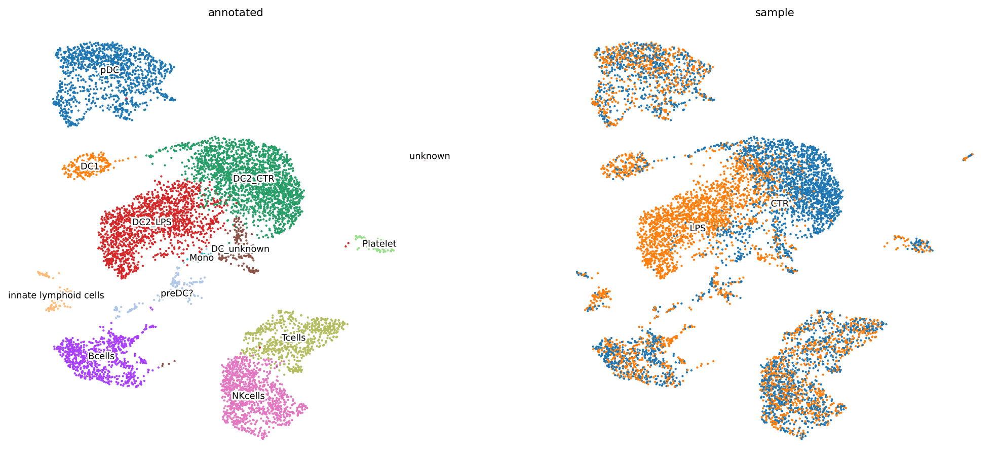

In [186]:
sb.set_context('paper')
pl.rcParams['figure.figsize']=(7,7)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.umap(adata, color=['annotated','sample'], legend_loc='on data',cmap=mymap,legend_fontoutline=3,vmax='p99.9',legend_fontsize='small', legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
cluster=samplename+"_Annotated.h5ad"
adata.write(cluster)

In [ ]:
cluster=samplename+"_Annotated.h5ad"
adata=sc.read(cluster)
adata

AnnData object with n_obs × n_vars = 12477 × 36484
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'D1_CTR,D2_CTR,D3_CTR', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2', 'leidenA', 'leidenB', 'annotated'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-2', 'mean_counts-2', 'log1p_mean_counts-2', 'pct_dropou

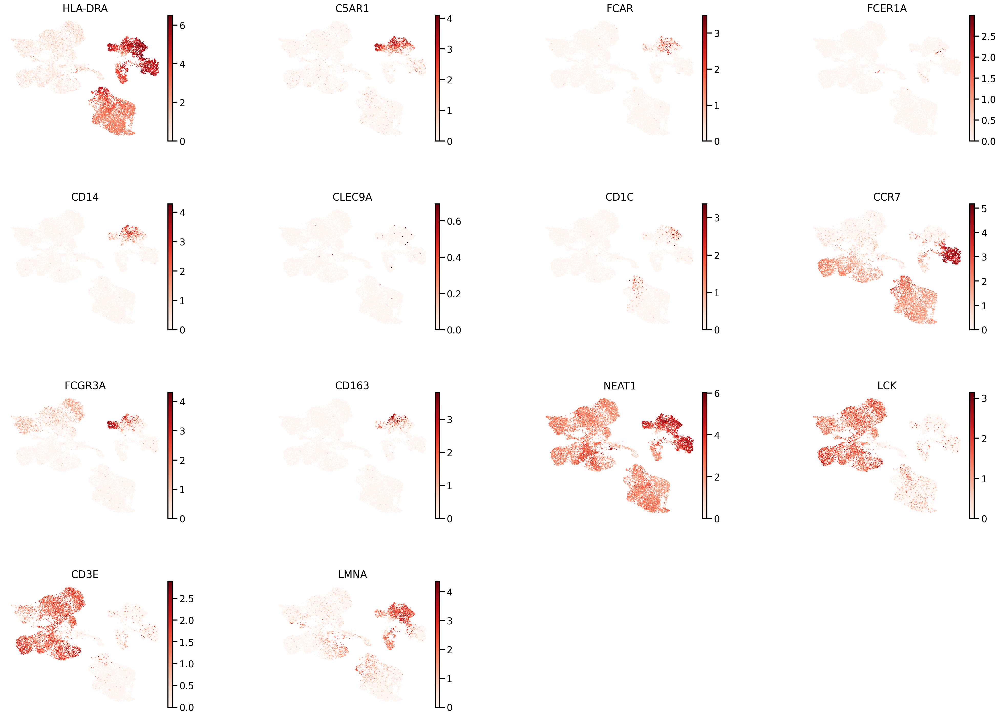

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_clustering_vst_bbknn.pdf"
sc.pl.umap(adata, color=['HLA-DRA','C5AR1','FCAR','FCER1A','CD14',"CLEC9A",'CD1C','CCR7','FCGR3A','CD163','NEAT1','LCK','CD3E','LMNA'],cmap=mymap,legend_fontoutline=3, 
           hspace=0.5,wspace=0.5,legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
sb.set_context('talk')
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_clustering_vst_bbknn__markers03.pdf"
sc.pl.umap(adata, color=['LAMP3', 'CCR7', 'CD83', 'NUB1', 'PLAC8', 'ARAP2', 'CLEC4C', 'PTPRS',
       'DAPP1', 'SLCO5A1', 'IRF8', 'PNRC1', 'DNASE1L3', 'DUSP5', 'CERS6',
       'COL24A1', 'LINC00996', 'ANXA5', 'ETV3', 'BASP1'],size=50,cmap=mymap,legend_fontoutline=3, 
           hspace=0.5,wspace=0.5,legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
adata


AnnData object with n_obs × n_vars = 4822 × 36484
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'sample_colors', 'scrublet', 'hvg', 'pca', 'pearson_residuals_normalization', 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_r0.2_colors', 'leiden_r0.3_colors', 'leiden_r0.4_colors',

In [ ]:
#PBMC marker genes
marker_genes = ['FOXP3','IDO1','IL7R', 'CD79A', 'MS4A1', 'CD4','CD8A', 'CD8B', 'LYZ', 'CD14','LGALS3', 'S100A8', 'GNLY', 'NKG7','NCR1', 'KLRB1','FCGR3A', 'MS4A7', 'FCER1A', 'CST3','HLA-DRA', 'PPBP']

In [ ]:
#Skin marker genes
marker_genes=['GATA3', 'KRTDAP', 'KRT1', 'DMKN', 'ITGA6', 'KRT14', 'KRT5', 'S100A2', 'CRYAB', 'TYRP1', 
'PTGDS', 'DCT', 'PMEL', 'FGL2', 'PMP22', 'LUM', 'APOD', 'NT5E', 'TNFAIP6', 'DCN', 
'CFD', 'RGS5', 'MGP', 'TFPI', 'CCL21', 'TFF3', 'FABP4', 'CD34', 'PECAM1', 'TM4SF1',
'SPARCL1', 'SERPINE1', 'KIT', 'TPSB2', 'TPSAB1', 'CTSG', 'GNLY', 'XCL2', 'XCL1', 
'KLRB1', 'IL7R', 'CXCR4', 'CD3E', 'CD8A', 'CD8B', 'CD7', 'CD3D', 'TRAC', 
'CD5', 'CD4', 'FOXP3', 'TIGIT', 'CD247', 'IGKC', 'IGLC2', 'IGHA1', 'GZMB', 
'JCHAIN', 'PLEK', 'ACOT7', 'HLA-DQB2', 'HLA-DQA1', 'CCR7', 'HLA-DRA', 'CXCL8', 'RNASE1', 
'CCL3','CD207','CD79A','KRT16','KRT17','KRT6A']

In [ ]:
marker_genes=['IRF4','IRF8','CD5','CD2','CADM1','CLEC9A','STMN1','GZMB','JCHAIN','LAMP3','BIRC3','CCR7','IDO1','IRF4','IRF8','TGFBI','FBP1','LGALS1','MT2A','IFIT3','IFI44','CD14','TXNIP','CD1D','CD33','CXCL8','IL1R2']

In [ ]:
print(len(marker_genes))
filter=np.in1d(marker_genes, adata.var_names)
marker_genes = list(np.array(marker_genes)[filter])
print(len(marker_genes))
marker_genes.append("leiden_r0.5")
marker_genes.append("condition")

27
27


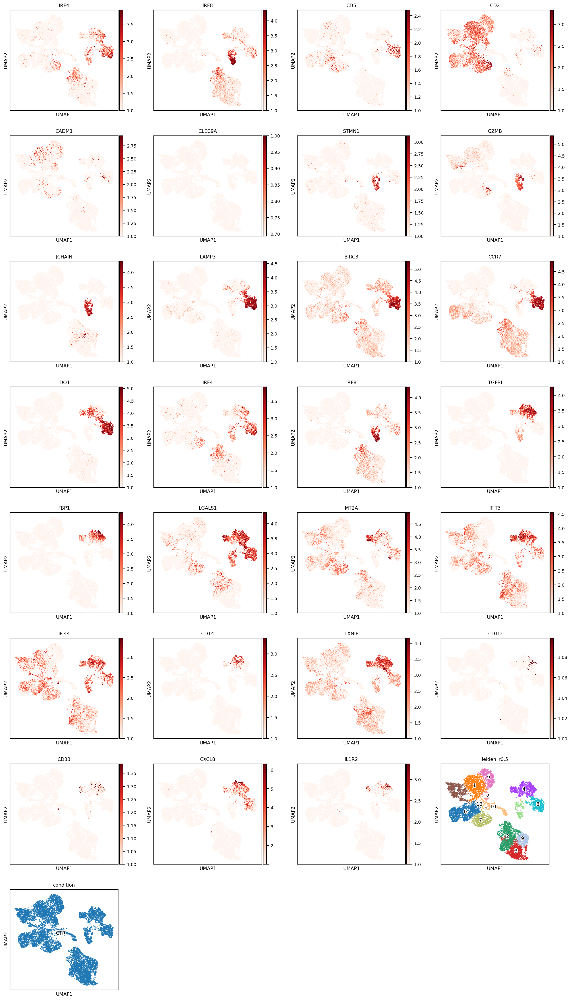

In [ ]:
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_markers_vst_2.pdf"
sc.pl.umap(adata=adata, color=marker_genes,color_map=mymap,vmin=1, vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=True, save=savefig)

# cell cell communication

In [ ]:
pip install scConnect

In [ ]:
import scConnect as cn

In [ ]:
# set correct database ONLY RUN WHEN DATABASE HAS CHANGED
cn.database.version = "2020-5"
#cn.database.setup_database("mmusculus", receptor_types=["lgic", "vgic", "gpcr", "catalytic_receptor"])

In [ ]:
sc.pp.filter_genes(adata, min_cells=10)

In [ ]:
adata

AnnData object with n_obs × n_vars = 12477 × 25171
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'D1_CTR,D2_CTR,D3_CTR', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2', 'leidenA', 'leidenB', 'annotated'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-2', 'mean_counts-2', 'log1p_mean_counts-2', 'pct_dropou

In [ ]:
adata.X=adata.X.todense()

In [ ]:
adata_tissue = cn.genecall.meanExpression(adata, groupby="annotated", normalization=False, use_raw=False, transformation="log1p")
pd.DataFrame(adata_tissue.uns["gene_call"])

,pDC,mregDC,DC3,DC2,Bcells,NKcells,NKT,gdTC,MAIT,CD8naive,CD4memory,CD4naive
MIR1302-2HG,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
FAM138A,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
OR4F5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
AL627309.1,0.006742,0.011315,0.019890,0.018182,0.010926,0.004776,0.006289,0.002803,0.0,0.006443,0.006803,0.004621
AL627309.3,0.002247,0.000000,0.001105,0.000000,0.000273,0.000000,0.001048,0.000000,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
AC141272.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
AC023491.2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
AC007325.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
AC007325.4,0.008989,0.014144,0.014365,0.010909,0.005736,0.009551,0.015723,0.011771,0.0,0.015464,0.025850,0.012939


In [ ]:
adata_tissue = cn.connect.ligands(adata_tissue)
adata_tissue = cn.connect.receptors(adata_tissue)

pd.DataFrame(adata_tissue.uns["ligands"]).head(10)

/usr/local/lib/python3.7/dist-packages/scipy/stats/stats.py:330: RuntimeWarning:

divide by zero encountered in log



,pDC,mregDC,DC3,DC2,Bcells,NKcells,NKT,gdTC,MAIT,CD8naive,CD4memory,CD4naive
4-1BB ligand,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5-LOX activating protein,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ACTH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ADP-ribosylation factor 1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
APRIL,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
B and T lymphocyte attenuator,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BAFF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BDNF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BMP-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BMP-2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
adata_tissue = cn.connect.specificity(adata_tissue, n=2000, groupby="annotated")
cn.connect.save_specificity(adata_tissue, "tissue_specificity.xlsx")

/usr/local/lib/python3.7/dist-packages/scipy/stats/stats.py:330: RuntimeWarning:

divide by zero encountered in log



Shuffeling dataframe 2000 out of 2000 |██████████████████████████████| 100.0% 
Calculating means...
Calculating standard deviations...
Calculating Z-score, p-values and corrected p-values...
97.83783783783784 % of group metrices were 0. increase n to reduce this number
99.71751412429379 % of group metrices were 0. increase n to reduce this number


In [ ]:
cn.connect.load_specificity(adata_tissue, "tissue_specificity.xlsx")

In [ ]:

edges = cn.connect.interactions(emitter=adata_tissue, target=adata_tissue, self_reference=True)
nodes = cn.connect.nodes(adata_tissue)

finding connections between 12 emitter clusters and 12 target clusters |██████████████████████████████| 100.0% 
precessing adata #1
processing cluster pDC
processing cluster mregDC
processing cluster DC3
processing cluster DC2
processing cluster Bcells
processing cluster NKcells
processing cluster NKT
processing cluster gdTC
processing cluster MAIT
processing cluster CD8naive
processing cluster CD4memory
processing cluster CD4naive


In [ ]:
G_tissue = cn.graph.build_graph(edges, nodes)

Graph has 0 interactions between 12 clusters
pDC has 0 interactions
mregDC has 0 interactions
DC3 has 0 interactions
DC2 has 0 interactions
Bcells has 0 interactions
NKcells has 0 interactions
NKT has 0 interactions
gdTC has 0 interactions
MAIT has 0 interactions
CD8naive has 0 interactions
CD4memory has 0 interactions
CD4naive has 0 interactions


In [ ]:
from dash import dcc

In [ ]:
pip install jupyter-dash -q

In [ ]:
from jupyter_dash import JupyterDash  # pip install dash
import dash_cytoscape as cyto  # pip install dash-cytoscape==0.2.0 or higher
import dash_html_components as html
import dash_core_components as dcc
from dash.dependencies import Output, Input
import pandas as pd  # pip install pandas
import plotly.express as px
import math
from dash import no_update

In [ ]:
cn.app.graph(G_tissue, mode="external")

ValueError: ignored

In [ ]:
import dash
import dash_core_components as dcc
import dash_html_components as html
import plotly.express as px
import pandas as pd



In [ ]:
from jupyter_dash import JupyterDash

In [ ]:
!pip install pyngrok --quiet

     |████████████████████████████████| 745 kB 5.4 MB/s 


In [ ]:
from pyngrok import ngrok
ngrok.kill()
NGROK_AUTH_TOKEN=""
ngrok.set_auth_token(NGROK_AUTH_TOKEN)

In [ ]:
%%sh
pip install -q dash
pip install -q dash_core_components
pip install -q dash_html_components
pip install -q dash_table

In [ ]:
ngrok.connect(8050)

<NgrokTunnel: "http://d34d-35-192-165-45.ngrok.io" -> "http://localhost:8050">

In [ ]:
Gs_tissue = cn.graph.split_graph(G_tissue)

In [ ]:
import ipywidgets as widgets

options = list(Gs_tissue.keys())
options.sort()


def f(interaction):
    return cn.graph.plot_adjacency_matrix(Gs_tissue[interaction], weight="log_score", width=400, height=400, fontsize=15, fontscale=1.0)

widgets.interact(f, interaction=widgets.Dropdown(options=options, index=0))

TraitError: ignored

In [ ]:
cn.graph.compare_interactions_plot(G_tissue, node_a="pDC", node_b="DC2", th=2, figsize_i=(10, 7), figsize_o=(10, 15))

receptor families in order: []


ValueError: ignored

# nanopore counts


In [ ]:
# Quality control - calculate QC covariates
nanopore.obs['n_counts'] = nanopore.X.sum(1)
nanopore.obs['log_counts'] = np.log(nanopore.obs['n_counts'])
nanopore.obs['n_genes'] = (nanopore.X > 0).sum(1)



# compute qc metrics
nanopore.var['mito'] = nanopore.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(nanopore, qc_vars=['mito'], percent_top=None, log1p=False, inplace=True)



nanopore

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:726: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


AnnData object with n_obs × n_vars = 8152 × 9382
    obs: 'n_counts', 'log_counts', 'n_genes', 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito'
    var: 'nanopore', 'mt', 'mito', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts'

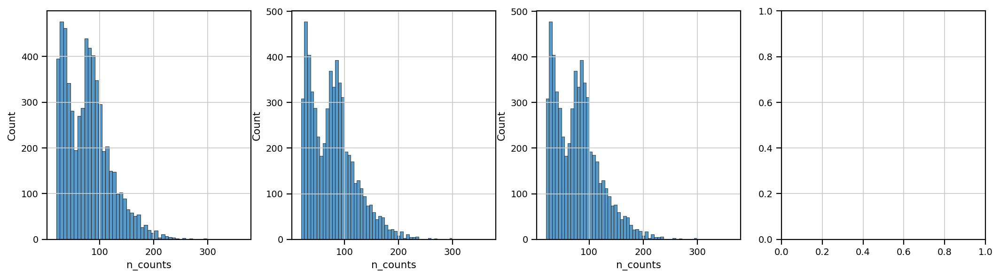

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3,ax4) = plt.subplots(1, 4, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sb.histplot(nanopore.obs['n_counts'], kde=False, ax=ax1,)
ax2_dict =  sb.histplot(nanopore.obs['n_counts'][nanopore.obs['n_counts']<10000], kde=False, bins=60, ax=ax2,)
ax3_dict =  sb.histplot(nanopore.obs['n_counts'][nanopore.obs['n_counts']<4000], kde=False, bins=60, ax=ax3,)
ax4_dict = sb.histplot(nanopore.obs['n_counts'][nanopore.obs['n_counts']>10000], kde=False, bins=60, ax=ax4, )
savefig='figures/'+samplename + '_2_QC_counts_filtering_nanopore.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

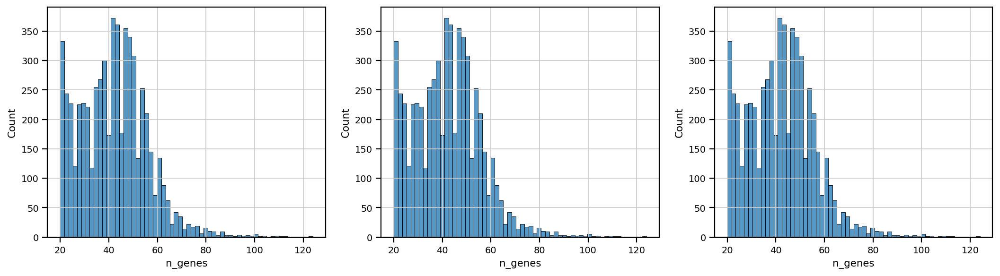

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sb.histplot(nanopore.obs['n_genes'], kde=False, bins=60, ax=ax1,)
ax2_dict =  sb.histplot(nanopore.obs['n_genes'][nanopore.obs['n_genes']<4000], kde=False, bins=60, ax=ax2,)
ax3_dict =  sb.histplot(nanopore.obs['n_genes'][nanopore.obs['n_genes']<1000], kde=False, bins=60, ax=ax3,)
savefig='figures/'+samplename + '_3_QC_gene_filtering_nanopore.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(nanopore.n_obs))

sc.pp.filter_cells(nanopore, min_counts = 30)
print('Number of cells after min count filter: {:d}'.format(nanopore.n_obs))

sc.pp.filter_cells(nanopore, max_counts = 50000)
print('Number of cells after max count filter: {:d}'.format(nanopore.n_obs))

nanopore = nanopore[nanopore.obs['pct_counts_mito'] < 0.3]
print('Number of cells after MT filter: {:d}'.format(nanopore.n_obs))

sc.pp.filter_cells(nanopore, min_genes = 20)
print('Number of cells after gene filter: {:d}'.format(nanopore.n_obs))

Total number of cells: 5980
Number of cells after min count filter: 5331


Trying to set attribute `.obs` of view, copying.


Number of cells after max count filter: 5331
Number of cells after MT filter: 5331
Number of cells after gene filter: 5331


In [ ]:
#Filter genes:
print('Total number of genes: {:d}'.format(nanopore.n_vars))

# Min 5 cells - filters out 0 count genes
sc.pp.filter_genes(nanopore, min_cells=3)
print('Number of genes after cell filter: {:d}'.format(nanopore.n_vars))


In [ ]:
nanopore.layers["counts"]=nanopore.X

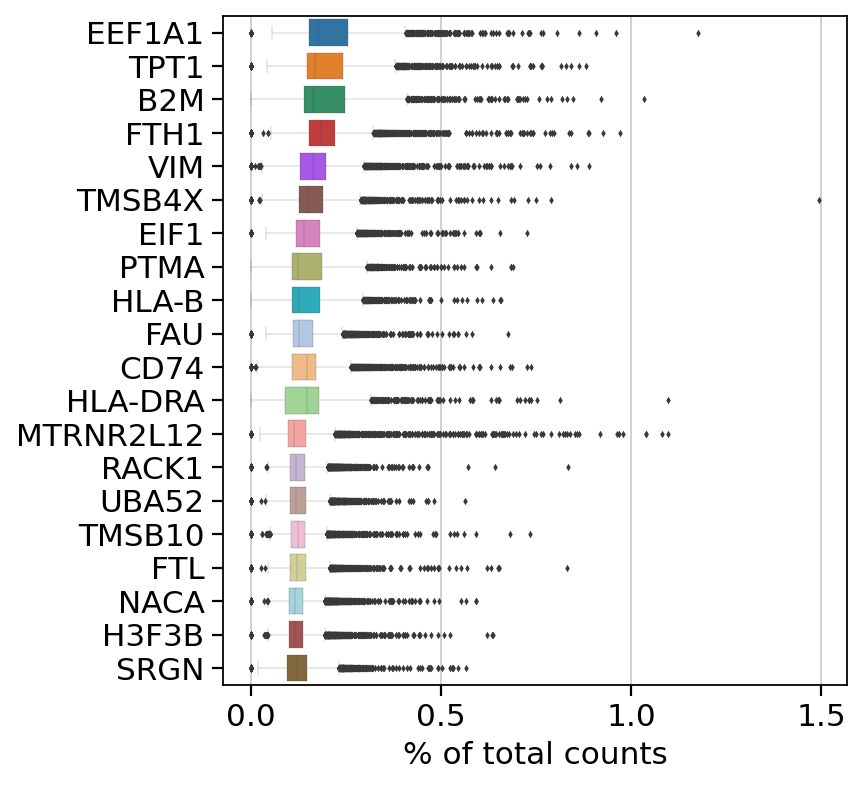

In [ ]:
sb.set_context('paper')
pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
sc.pl.highest_expr_genes(adata, n_top=20,save='top20_shortreads.pdf' )

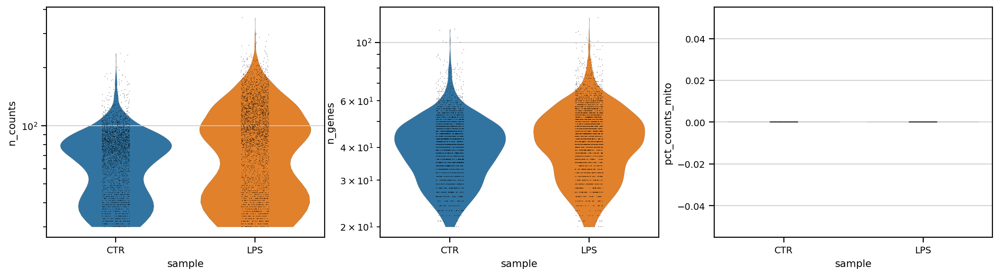

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.violin(nanopore, 'n_counts', groupby='sample', size=0.5, log=True, cut=0, ax=ax1, show=False)
ax2_dict =  sc.pl.violin(nanopore, 'n_genes', groupby='sample', size=0.5, log=True, cut=0, ax=ax2, show=False)
ax3_dict = sc.pl.violin(nanopore, 'pct_counts_mito', groupby='sample',size=0.5, ax=ax3, show=False,)
savefig='figures/'+samplename + '_1_QC_violin_plots_nanopore.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
nanopore.layers["raw"] = nanopore.X.copy()
nanopore.layers["sqrt_norm"] = np.sqrt(
    sc.pp.normalize_total(nanopore, inplace=False)["X"])

# Normalization

In [ ]:
sc.experimental.pp.recipe_pearson_residuals(nanopore,n_top_genes=1000,n_comps=100,random_state=42,inplace=True,)
#sc.experimental.pp.recipe_pearson_residuals(adata,n_top_genes=2000,n_comps=100,random_state=42,inplace=True,batch_key= 'sample')
nanopore

AnnData object with n_obs × n_vars = 5331 × 4854
    obs: 'n_counts', 'log_counts', 'n_genes', 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito'
    var: 'nanopore', 'mt', 'mito', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'sample_colors', 'hvg', 'pca', 'pearson_residuals_normalization'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'raw', 'sqrt_norm'

In [ ]:
nanopore.layers["normalized"]=nanopore.X
sc.pp.log1p(nanopore)
nanopore.layers["logcounts"] = nanopore.X

In [ ]:
sc.pp.neighbors(nanopore, n_pcs=50,n_neighbors=10,random_state=random_state)
#bbknn.bbknn(adata,batch_key = "sample", neighbors_within_batch =20, n_pcs = 100)


/usr/local/lib/python3.7/site-packages/scanpy/tools/_tsne.py:115: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  "In previous versions of scanpy, calling tsne with n_jobs > 1 would use "
/usr/local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


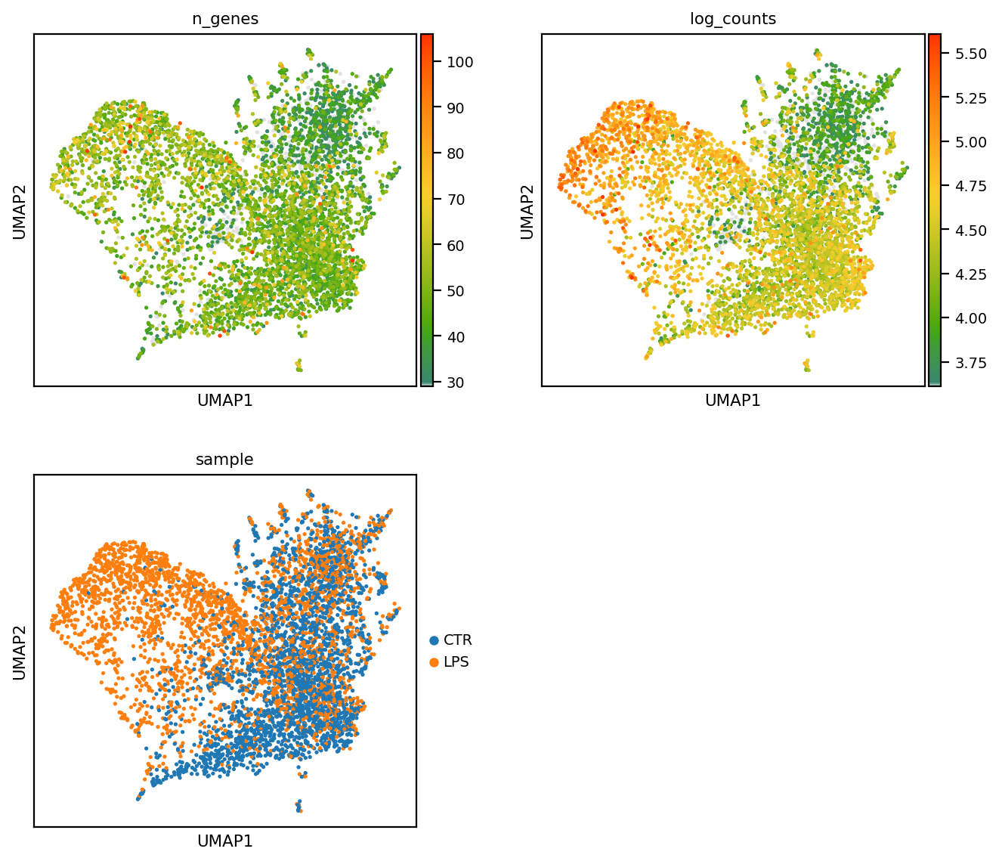

In [ ]:
genes_to_plot = ['n_genes','log_counts','sample']
sc.tl.tsne(nanopore,random_state=42) 
sc.tl.umap(nanopore,random_state=42)
savefig="_4_QC_doublets_vst_mito_nanopore.pdf"
sc.pl.umap(nanopore, color = genes_to_plot,ncols=2,cmap=mymap,vmin='p10',vmax='p99.9',save=savefig)